In [1]:
%matplotlib notebook

from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import os
import yaml
import subprocess
from time import time

import piff
import galsim
decaminfo = piff.des.DECamInfo()


In [2]:
# all code is here
from makeStarsMoments import return_config,makeStarsMoments,moment_str

# always run this                                                                                                                                                   
np.random.seed(12345)
rng = galsim.BaseDeviate(12345)

# make psf                                                                                                                                                          
config = return_config()
psf = piff.PSF.process(config)

In [35]:
# files to use
# get x,y,fit_params
exps = np.load("/u/ec/roodman/Astrophysics/Piff/exposure_filenames.npy")

vars = ['atmo_size', 'atmo_g1', 'atmo_g2', 'L0', 'optics_size', 'optics_g1', 'optics_g2', 
        'z04', 'z05', 'z06', 'z07', 'z08', 'z09', 'z10', 'z11']

nfiles = 1
for i in range(nfiles):
    print("File # ",i,exps[i])
    hf = pd.read_hdf(exps[i])
    hf['L0'] = 25.0
    nentries = len(hf)
    if i==0:
        x = hf.x.values
        y = hf.y.values
        fit_params = hf[vars].values
    else:
        x = np.append(x,hf.x.values)
        y = np.append(y,hf.y.values)
        fit_params = np.append(fit_params,hf[vars].values,axis=0)
        
# randomize L0, which is otherwise fixed
fit_params[:,3] = np.random.uniform(7.0,40.,fit_params.shape[0])
        
print("N stars = ",fit_params.shape)

File #  0 /nfs/slac/kipac/fs1/g/des/aresh/old_fit_checks_and_other_stuff/fit_checks_round3/multi_exposure_fit_check_third_moments_weight_40_hundredths_by_fit_psf_all_bands_together_old_fit_analytic/00514530/shapes_test_psf_optatmo_const_gpvonkarman.h5
N stars =  (445, 15)


In [38]:
print(x[0:10])
print(fit_params[0:10,3])

[1616.75397866 1150.69183549 1601.08777497  661.4554175  1594.16969903
 1882.66442007  543.39453327 1768.56589898  323.68174968 1273.2214736 ]
[ 9.84536247 11.71718565 24.02227513 29.74826388 35.26865176 28.36293555
 26.19341629 30.46682652 15.32975628 36.70526955]


In [39]:
nlevels = 1
pixel_sum = [40000.]
foreground = [200.]
##%pdb
df = makeStarsMoments(x,y,fit_params,psf,rng,nlevels,pixel_sum,foreground)

Done with makeall stars


In [40]:
print(df.columns[0:100])
print(df.columns[100:200])

Index(['Sum', 'Foreground', 'M00_nonoise', 'M10_nonoise', 'M01_nonoise',
       'M11_nonoise', 'M20_nonoise', 'M02_nonoise', 'M21_nonoise',
       'M12_nonoise', 'M30_nonoise', 'M03_nonoise', 'M31_nonoise',
       'M13_nonoise', 'M40_nonoise', 'M04_nonoise', 'M22_nonoise',
       'M33_nonoise', 'M44_nonoise', 'M22n_nonoise', 'M33n_nonoise',
       'M44n_nonoise', 'varM00_nonoise', 'varM10_nonoise', 'varM01_nonoise',
       'varM11_nonoise', 'varM20_nonoise', 'varM02_nonoise', 'varM21_nonoise',
       'varM12_nonoise', 'varM30_nonoise', 'varM03_nonoise', 'varM31_nonoise',
       'varM13_nonoise', 'varM40_nonoise', 'varM04_nonoise', 'varM22_nonoise',
       'varM33_nonoise', 'varM44_nonoise', 'varM22n_nonoise',
       'varM33n_nonoise', 'varM44n_nonoise', 'flux_nonoise', 'u0_nonoise',
       'v0_nonoise', 'sigma_m_nonoise', 'e1_nonoise', 'e2_nonoise',
       'M00_pkernel', 'M10_pkernel', 'M01_pkernel', 'M11_pkernel',
       'M20_pkernel', 'M02_pkernel', 'M21_pkernel', 'M12_pkernel',
    

/nfs/slac/g/ki/ki06/roodman/Software/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


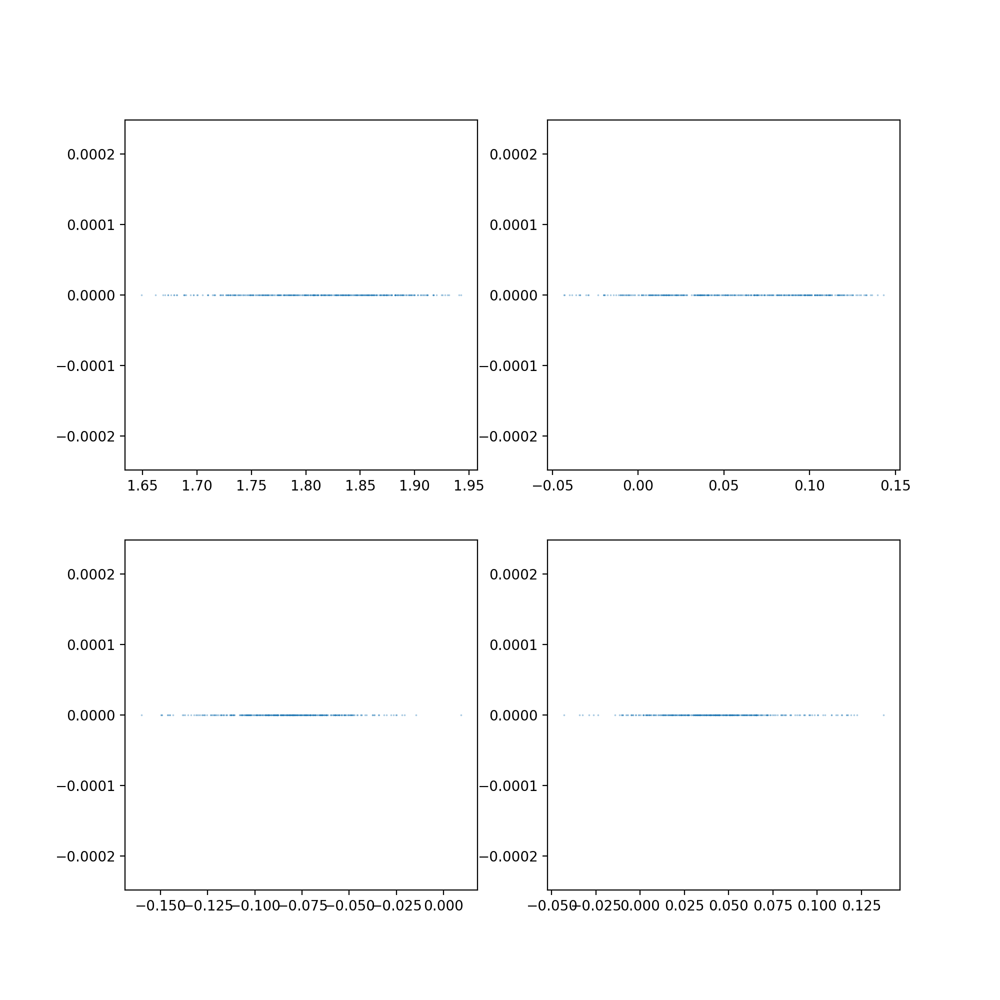

In [41]:
# now have exactly matched output to HSM!
f,axa = plt.subplots(2,2,figsize=(10,10))
ax = axa.flatten()
df['sigma_noise'] = df.sigma_m_noise/(1-df.e1_noise*df.e1_noise-df.e2_noise*df.e2_noise)**(.25)
p = ax[0].scatter(x=2.355*df.sigma_noise,y=df.M11_noise-df.sigma_noise*df.sigma_noise,marker='.',s=0.1)
p = ax[1].scatter(x=df.u0_noise,y=df.u0_noise-df.M10_noise,marker='.',s=0.1)
p = ax[2].scatter(x=df.e2_noise,y=df.e2_noise-df.M02_noise/df.M11_noise,marker='.',s=0.1)
p = ax[3].scatter(x=df.e1_noise,y=df.e1_noise-df.M20_noise/df.M11_noise,marker='.',s=0.1)





In [42]:
astar = noisy_stars_list[2][0]
data, weight, u, v = astar.data.getDataVector(include_zero_weight=True)

f = plt.figure()
plt.imshow(data.reshape(19,19),interpolation='None',origin='lower')
plt.colorbar()

image, weight, image_pos = astar.data.getImage()

mom = image.FindAdaptiveMom(weight=weight, strict=False)

sigma = mom.moments_sigma
shape = mom.observed_shape
# These are in pixel coordinates.  Need to convert to world coords.
jac = image.wcs.jacobian(image_pos=image_pos)
scale, shear, theta, flip = jac.getDecomposition()

print('WCS Scale = ',scale,' Shear = ',shear,' Theta = ',theta,' Flip = ',flip)

NameError: name 'noisy_stars_list' is not defined

In [60]:
# make 50 files worth of stars...

# run jobs...
for i in range(50):
    command = "bsub -C 0  -W 1:00 -R select[rhel60] -o stars/makeStars_%d.log ./makeem.py -n %d -o stars/makeStars_%d.pkl" % (i,i,i)
    os.system(command)
    print(command)

bsub -C 0  -W 1:00 -R select[rhel60] -o stars/makeStars_0.log ./makeem.py -n 0 -o stars/makeStars_0.pkl
bsub -C 0  -W 1:00 -R select[rhel60] -o stars/makeStars_1.log ./makeem.py -n 1 -o stars/makeStars_1.pkl
bsub -C 0  -W 1:00 -R select[rhel60] -o stars/makeStars_2.log ./makeem.py -n 2 -o stars/makeStars_2.pkl
bsub -C 0  -W 1:00 -R select[rhel60] -o stars/makeStars_3.log ./makeem.py -n 3 -o stars/makeStars_3.pkl
bsub -C 0  -W 1:00 -R select[rhel60] -o stars/makeStars_4.log ./makeem.py -n 4 -o stars/makeStars_4.pkl
bsub -C 0  -W 1:00 -R select[rhel60] -o stars/makeStars_5.log ./makeem.py -n 5 -o stars/makeStars_5.pkl
bsub -C 0  -W 1:00 -R select[rhel60] -o stars/makeStars_6.log ./makeem.py -n 6 -o stars/makeStars_6.pkl
bsub -C 0  -W 1:00 -R select[rhel60] -o stars/makeStars_7.log ./makeem.py -n 7 -o stars/makeStars_7.pkl
bsub -C 0  -W 1:00 -R select[rhel60] -o stars/makeStars_8.log ./makeem.py -n 8 -o stars/makeStars_8.pkl
bsub -C 0  -W 1:00 -R select[rhel60] -o stars/makeStars_9.log ./

In [61]:
pixel_sum = [10000.,40000.,100000.]

# concatenate all pickles
dflist = []
for i in range(50):
    onedf = pd.read_pickle("stars/makeStars_%d.pkl" % (i))
    dflist.append(onedf)
    
df = pd.concat(dflist)

In [62]:
from matplotlib.backends.backend_pdf import PdfPages

def makepullplots(vname,perfect=False,pdf=None):
    
    f,ax = plt.subplots(2,3,figsize=(12,8))

    fstr = ['low','med','high']
    
    name_noise = "%s_noise" % (vname)
    name_perfect = "%s_pkernel" % (vname)
    name_nonoise = "%s_nonoise" % (vname)
    name_sigma = "var%s_noise" % (vname)
    name_perfectsigma = "var%s_pkernel" % (vname)
    
    rmslist = []

    for i in range(3):
        use = ( (df.Sum == pixel_sum[i]) & (df.M00_noise>0.) )
        dft = df[use]
    
        if perfect :
            diff = dft[name_perfect] - dft[name_nonoise]  
            pull = diff/np.sqrt(dft[name_perfectsigma])
        else:
            diff = dft[name_noise] - dft[name_nonoise]
            pull = diff/np.sqrt(dft[name_sigma])
    
        h = ax[0,i].hist(diff,bins=100)
        h = ax[1,i].hist(pull,bins=100,range=(-10,10))
    
        ax[0,i].set_xlabel(' %s Measured-True' % (vname))
        ax[1,i].set_xlabel(' %s Pull' % (vname))

        plt.text(0.1, 0.9, '%s flux' % (fstr[i]) , horizontalalignment='left',verticalalignment='center', transform=ax[0,i].transAxes)
    
        rmslist.append(np.std(pull))
        plt.text(0.1, 0.9, r'$\sigma$ = %4.2f' % rmslist[i], horizontalalignment='left',verticalalignment='center', transform=ax[1,i].transAxes)

    if perfect:
        plt.suptitle('Perfect Kernel')

    if pdf:
        pdf.savefig(f)
        
    return rmslist[2]

    

/nfs/slac/g/ki/ki06/roodman/Software/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


<IPython.core.display.Javascript object>


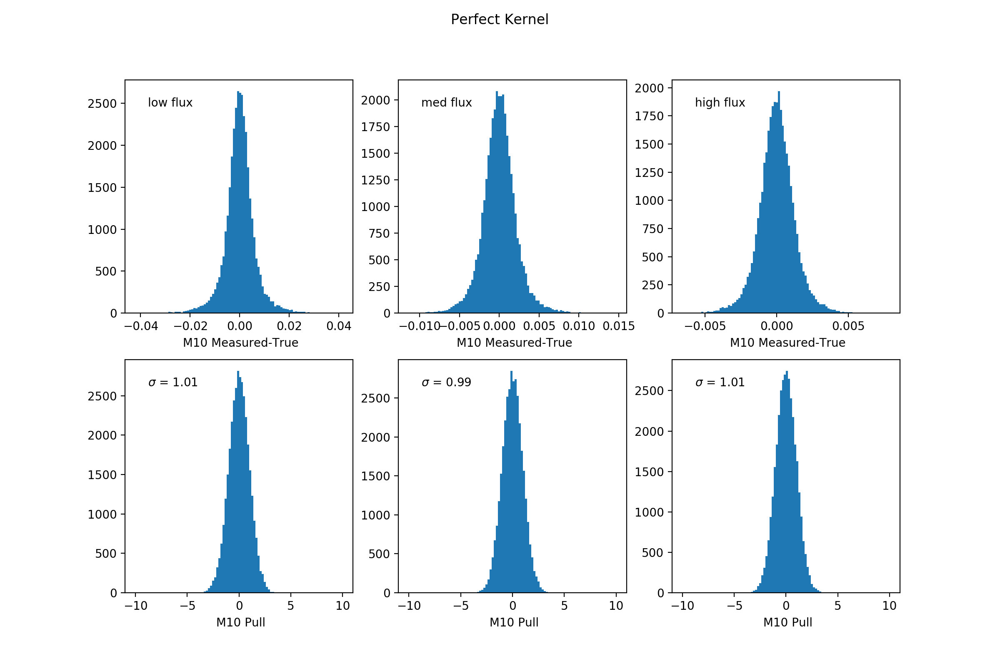

<IPython.core.display.Javascript object>


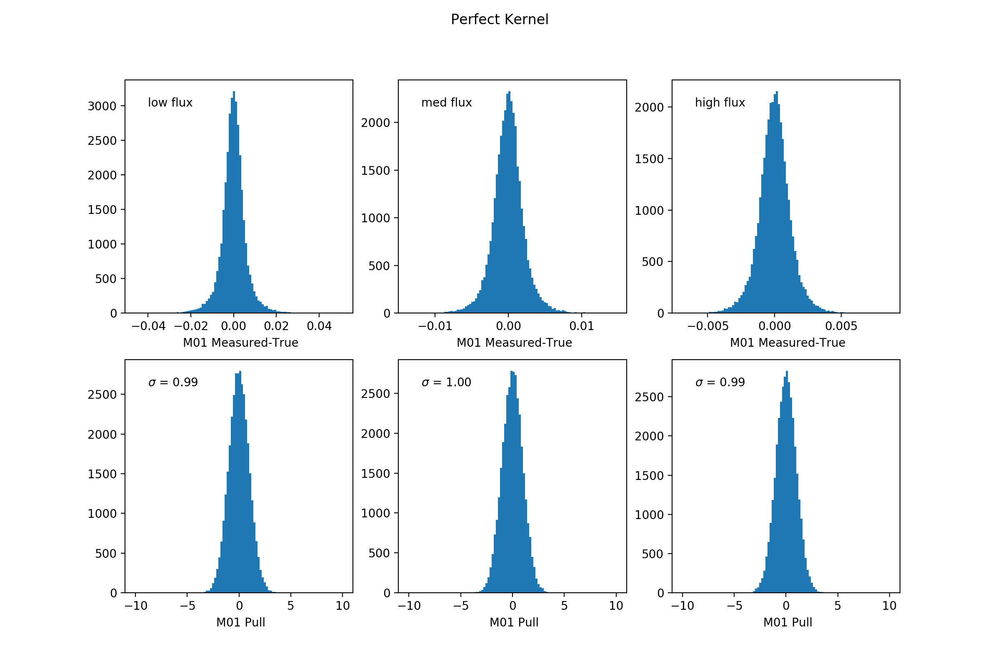

<IPython.core.display.Javascript object>


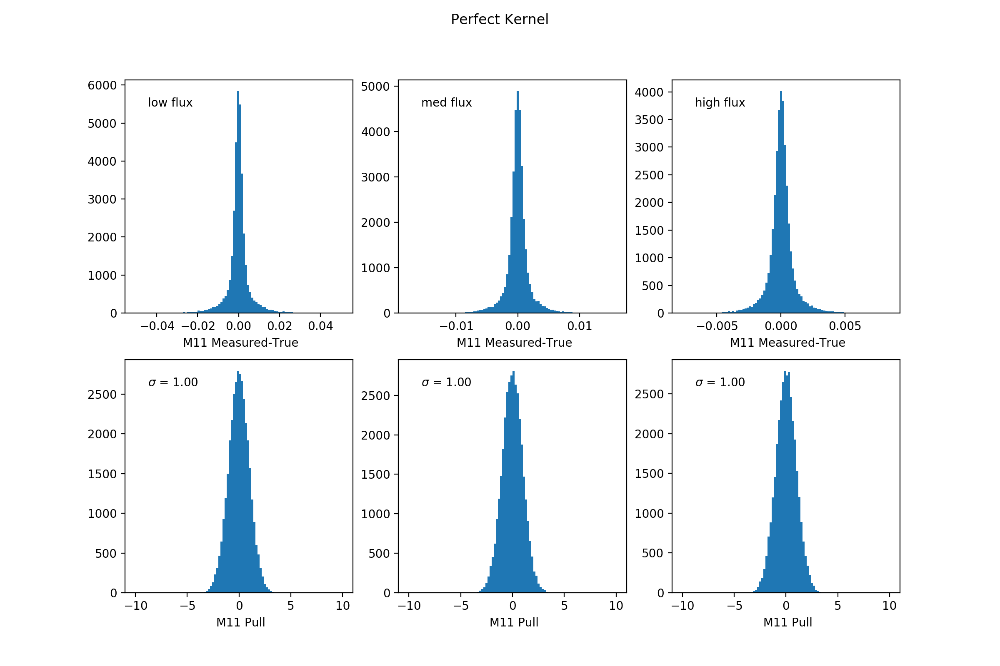

<IPython.core.display.Javascript object>


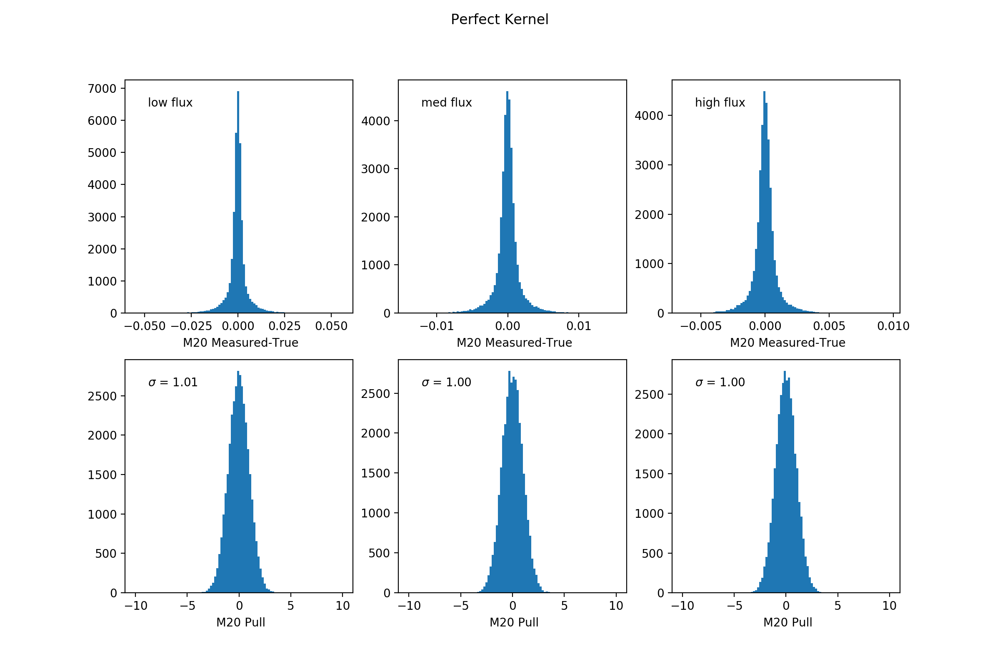

<IPython.core.display.Javascript object>


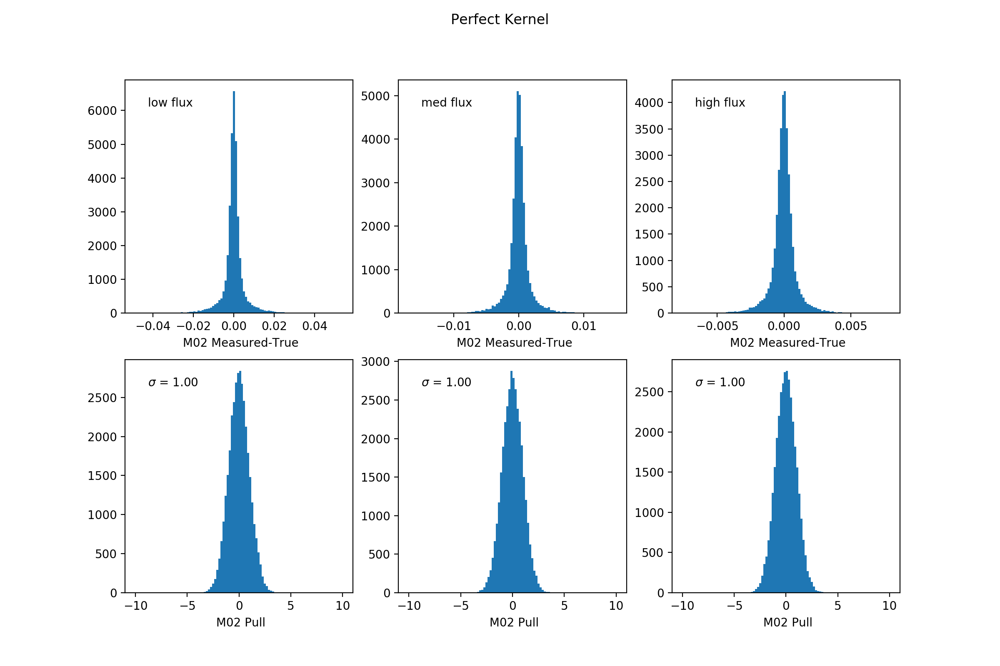

<IPython.core.display.Javascript object>


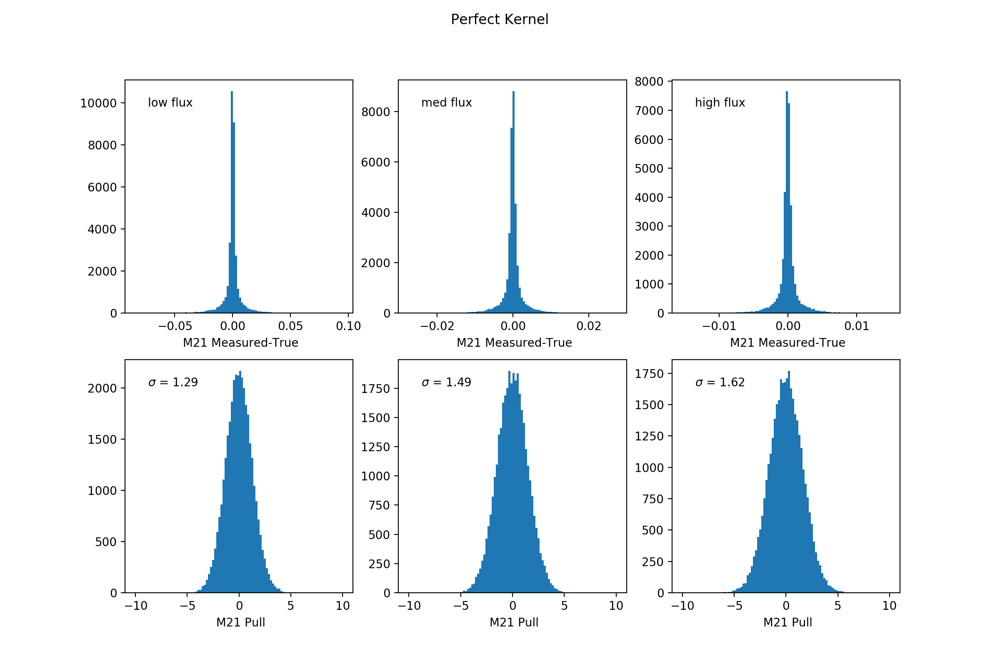

<IPython.core.display.Javascript object>


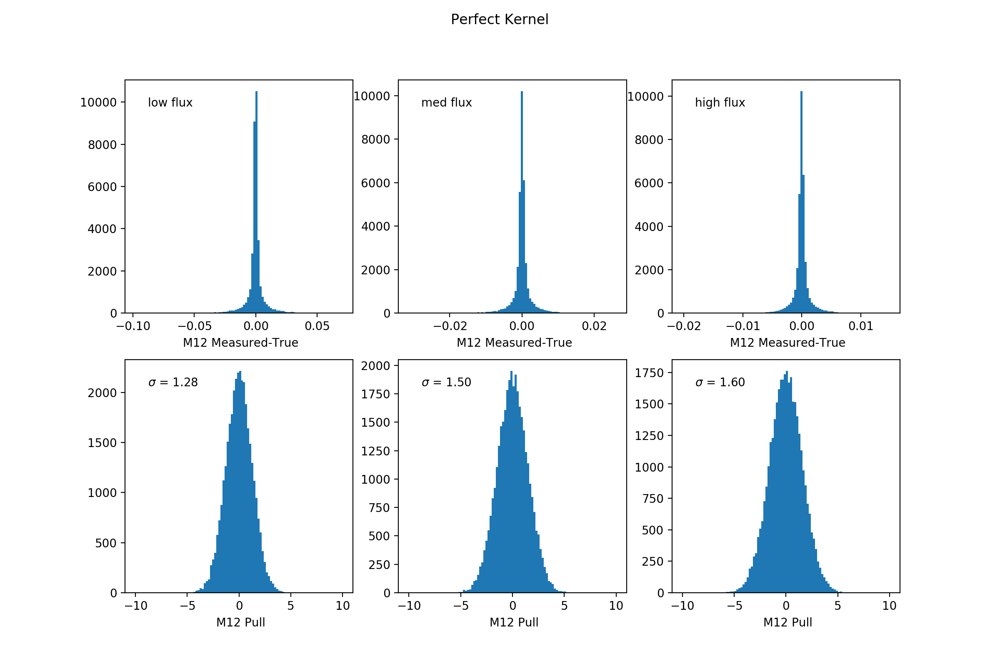

<IPython.core.display.Javascript object>


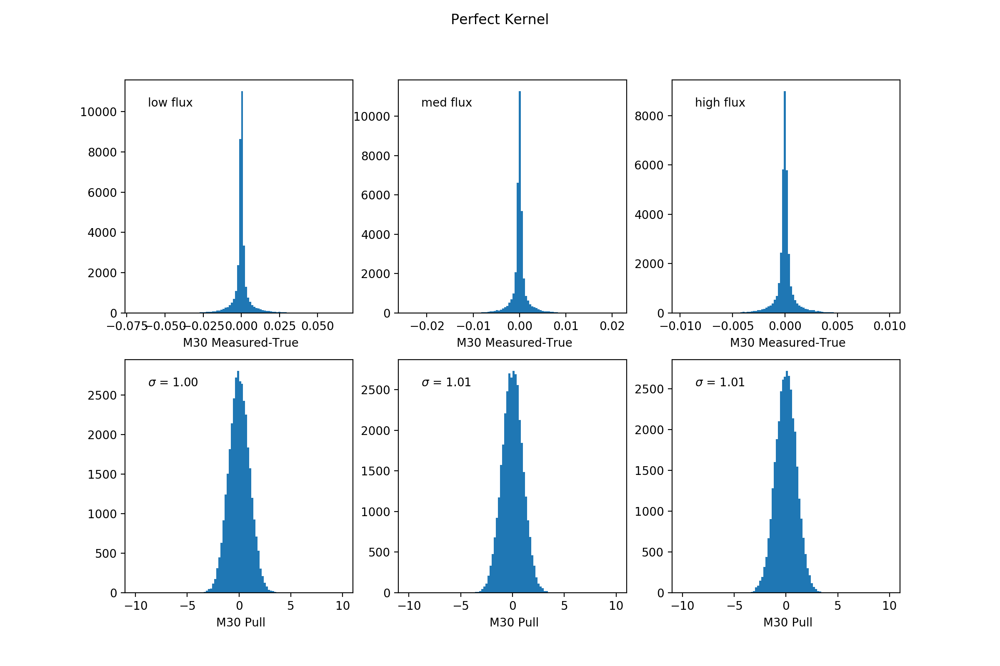

<IPython.core.display.Javascript object>


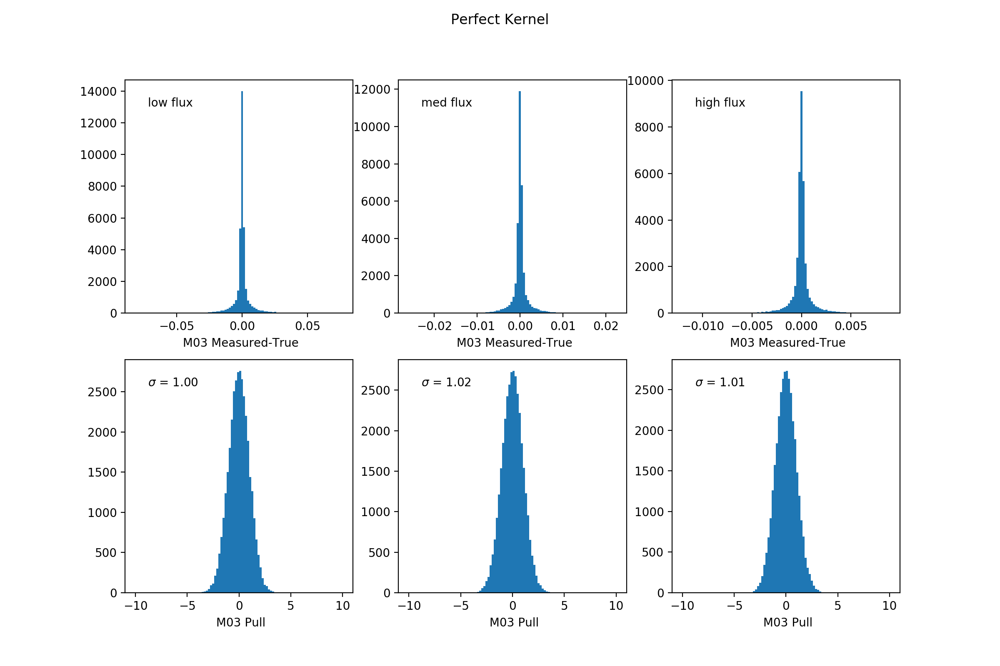

<IPython.core.display.Javascript object>


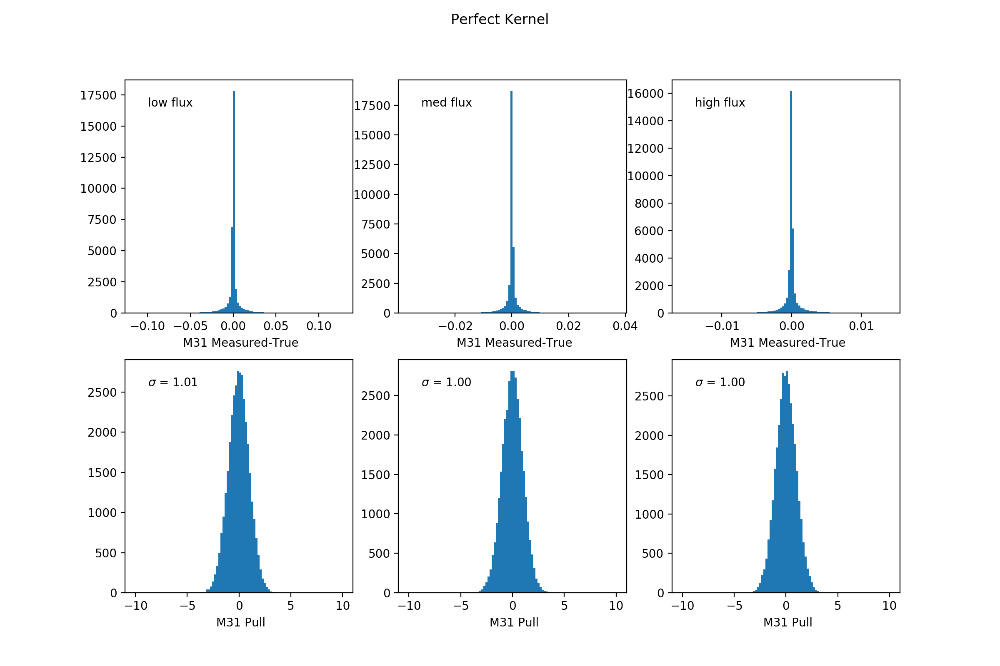

<IPython.core.display.Javascript object>


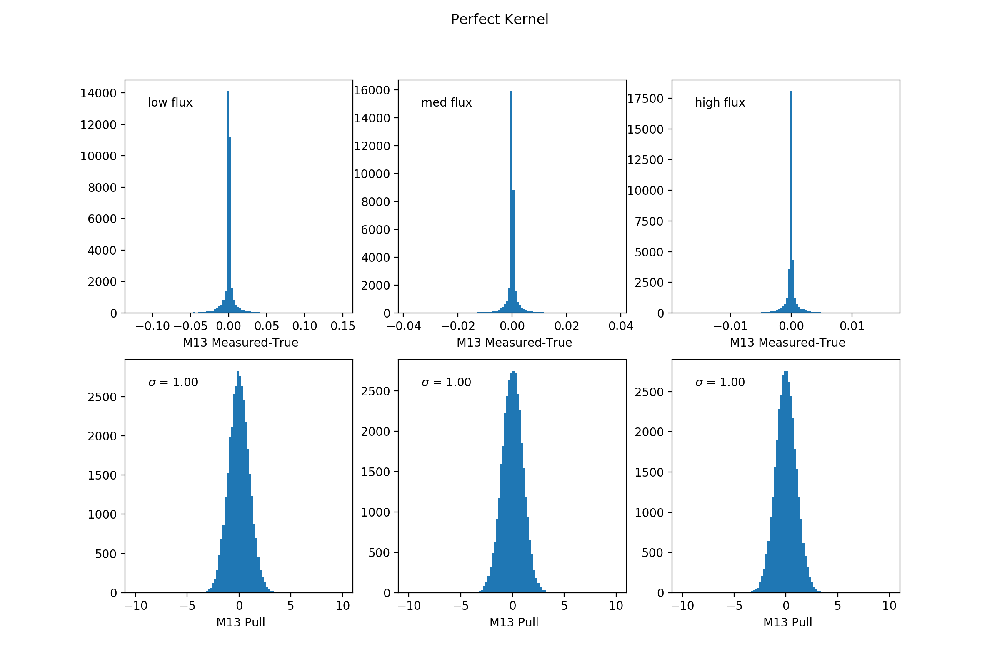

<IPython.core.display.Javascript object>


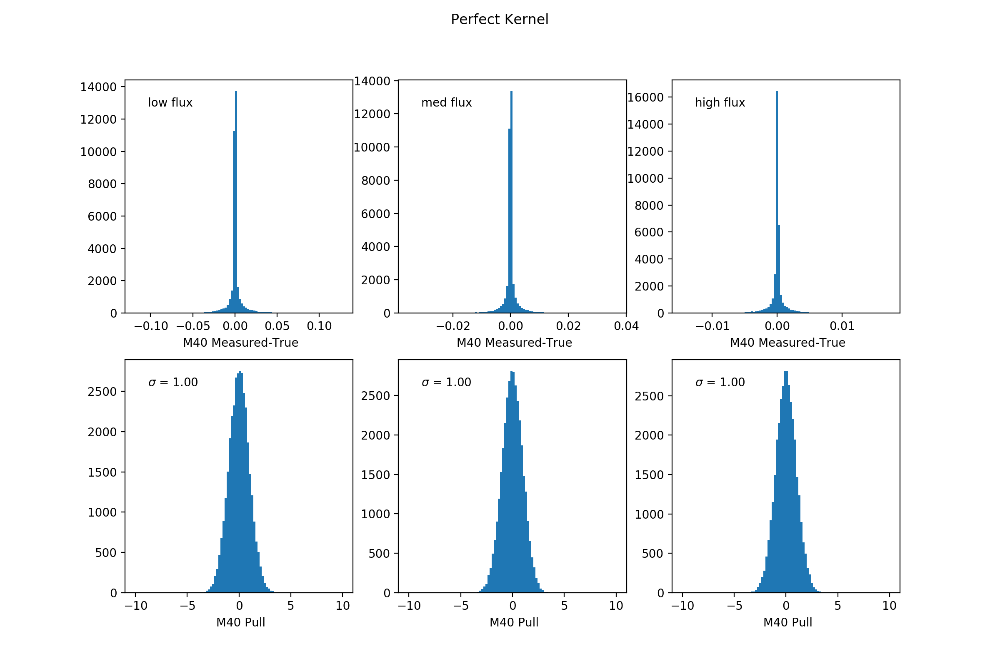

<IPython.core.display.Javascript object>


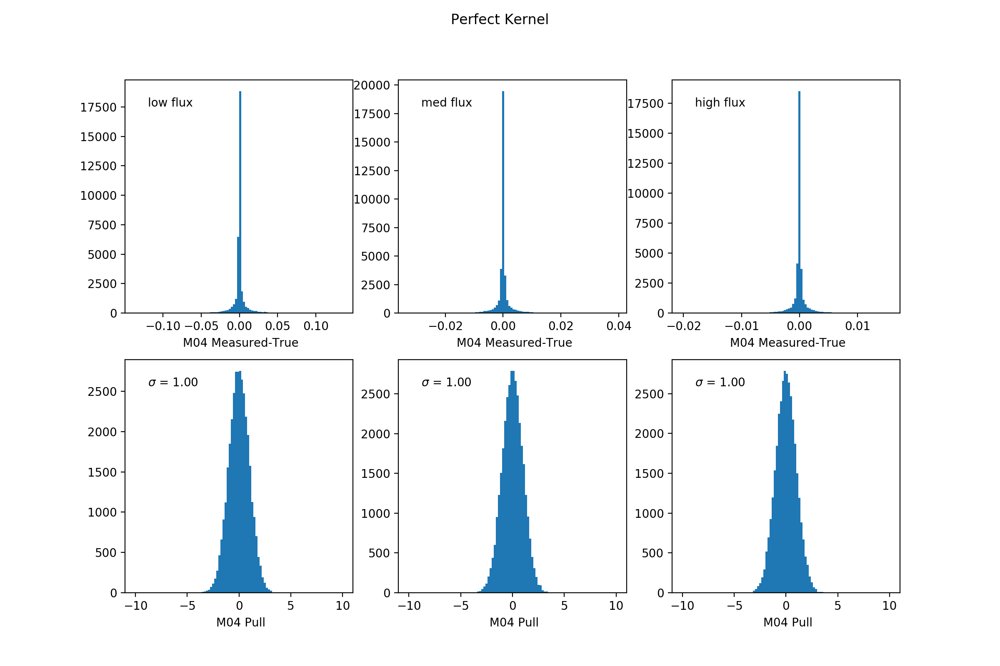

<IPython.core.display.Javascript object>


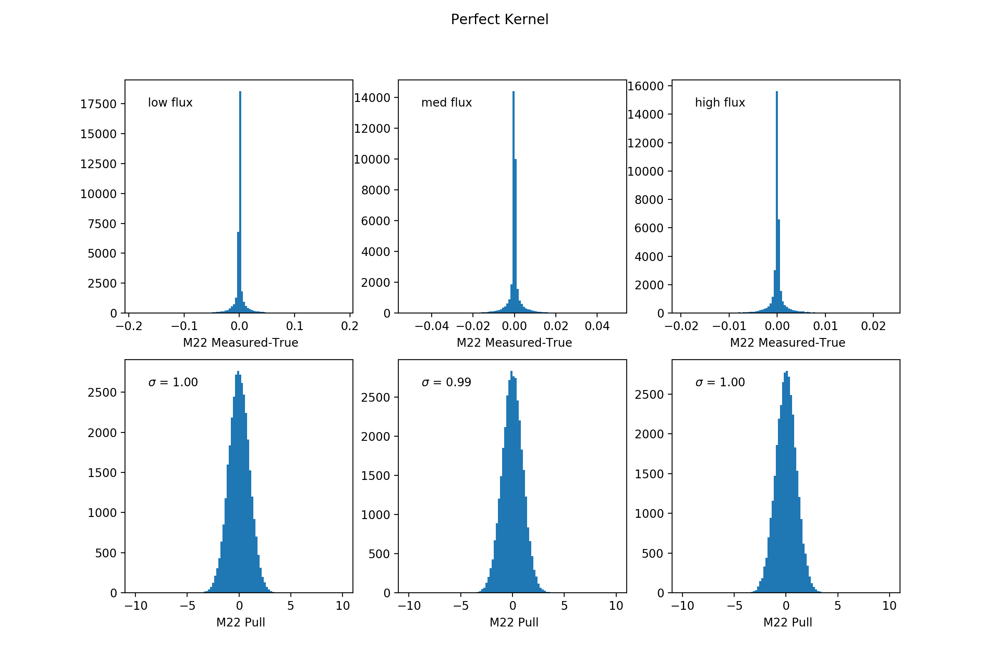

<IPython.core.display.Javascript object>


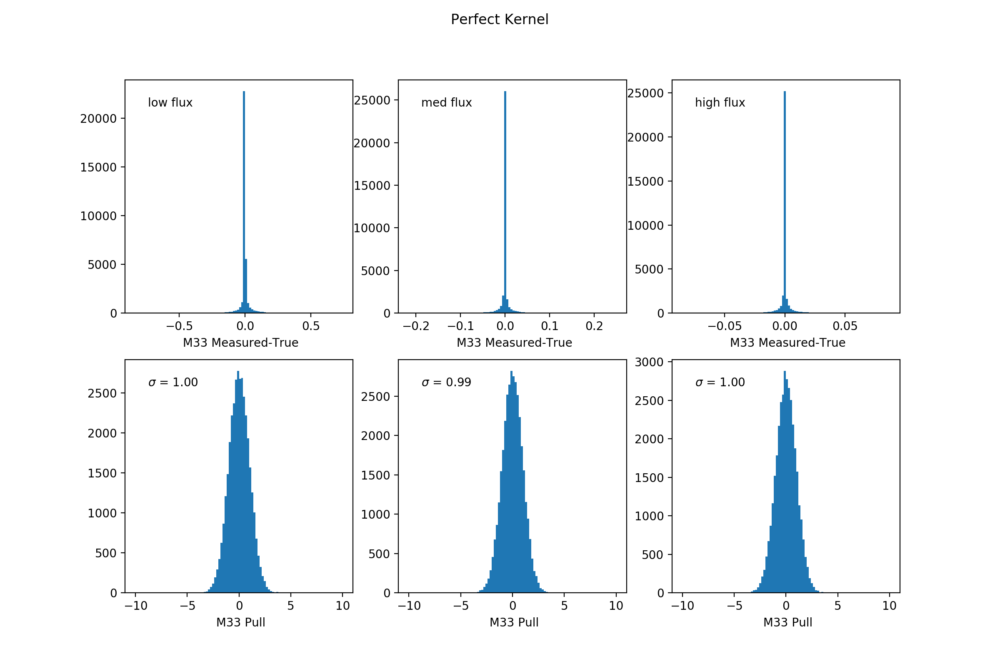

<IPython.core.display.Javascript object>


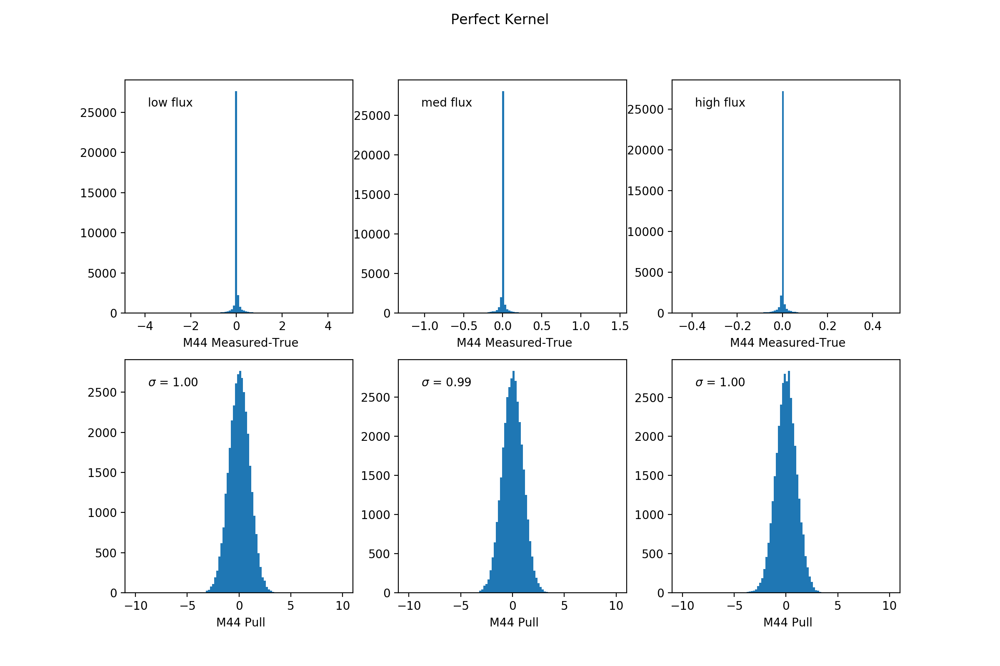

<IPython.core.display.Javascript object>


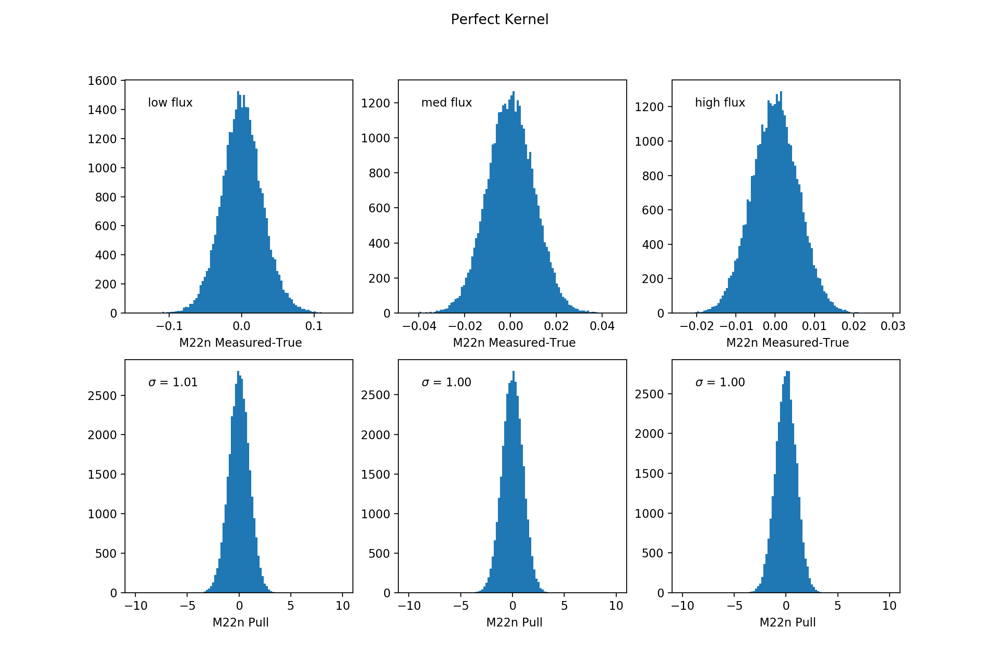

<IPython.core.display.Javascript object>


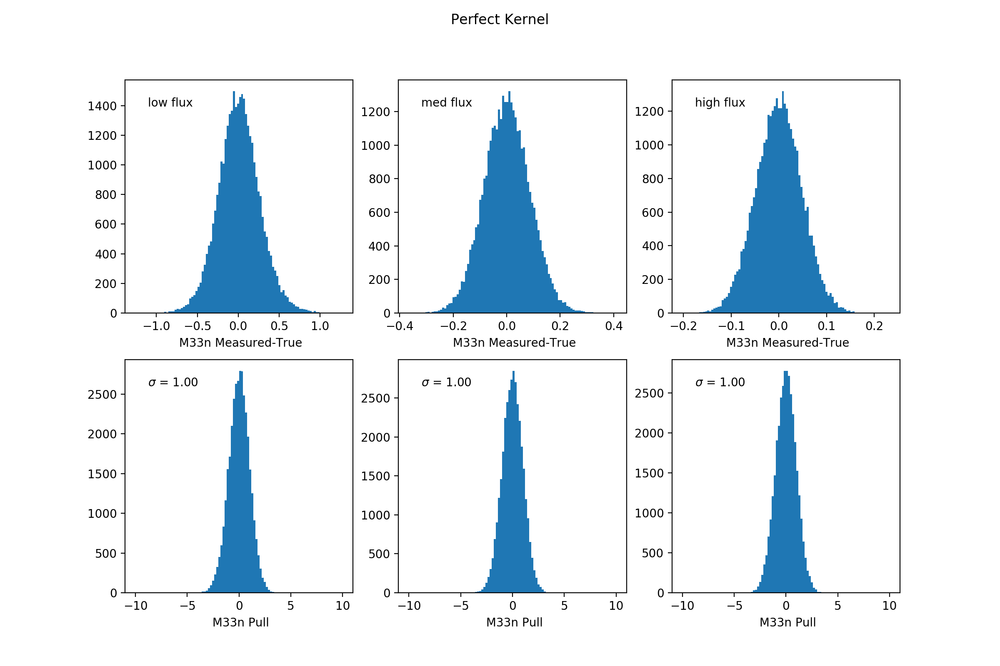

<IPython.core.display.Javascript object>


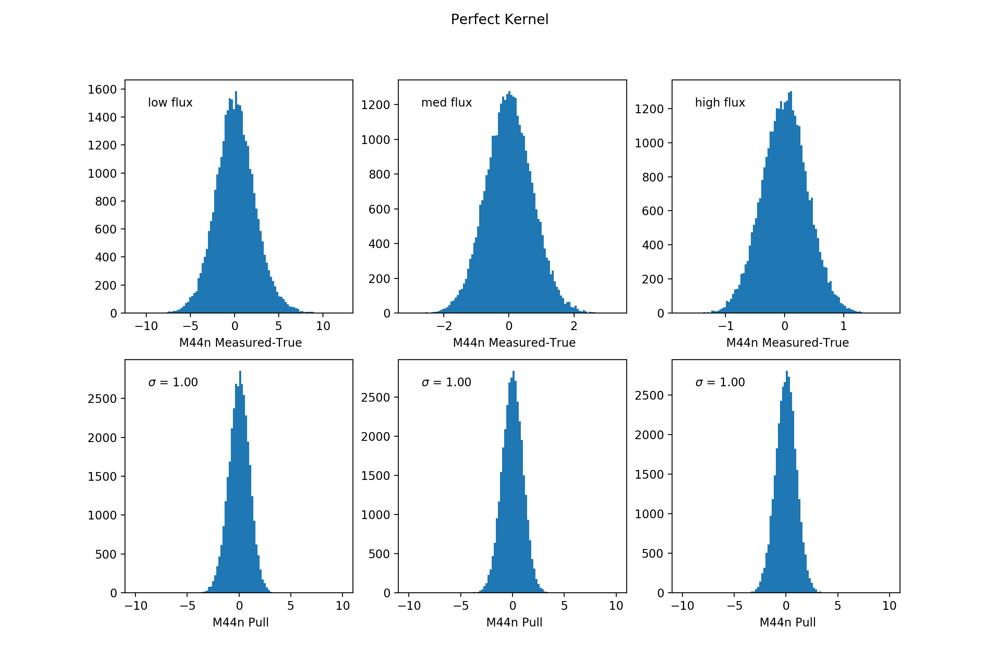

[1.0069367573324224, 0.9947077993724407, 0.9999955478646537, 0.9994661231027856, 1.0045017925139343, 1.6176605862999058, 1.5981034859904126, 1.0094304524735978, 1.0134925945812536, 0.9957143762720979, 1.002993287481516, 0.9982284088115787, 1.0032090569128, 1.0005827343526958, 1.0023712085853764, 1.0034255086032597, 1.0030125426177248, 1.0031810069387301, 1.0024226075399]


In [63]:
pdf = PdfPages("moments-perfectkernel.pdf")

momentlist = ['M10','M01','M11','M20','M02','M21','M12','M30','M03','M31','M13','M40','M04','M22','M33','M44','M22n','M33n','M44n']
rmslist_perfect = []

for i,amoment in enumerate(momentlist):
    rmslist_perfect.append(makepullplots(amoment,perfect=True,pdf=pdf))

pdf.close()
print(rmslist_perfect)


/nfs/slac/g/ki/ki06/roodman/Software/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


<IPython.core.display.Javascript object>


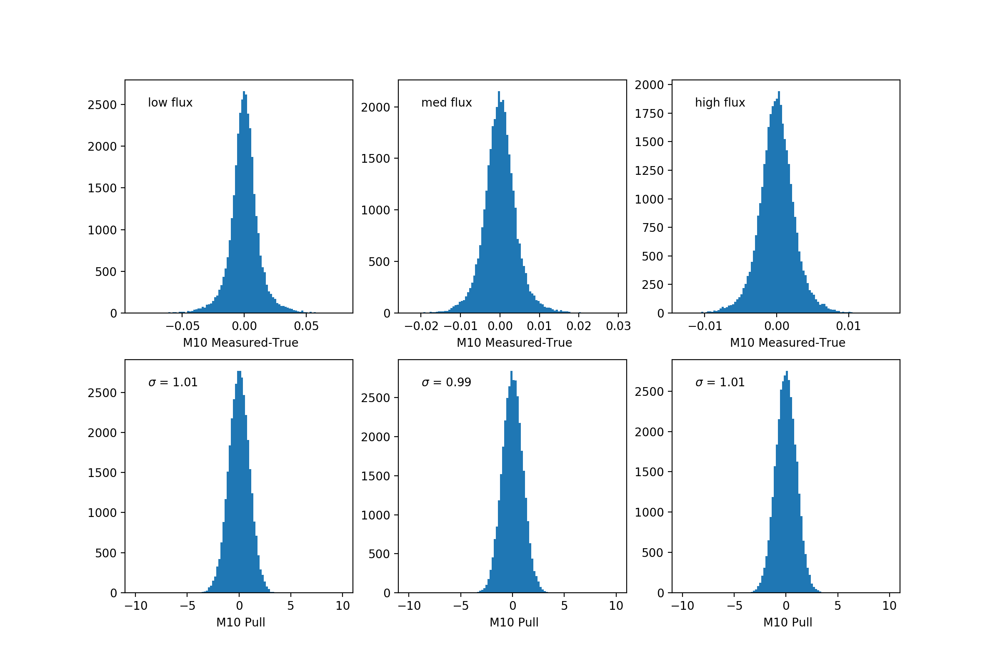

<IPython.core.display.Javascript object>


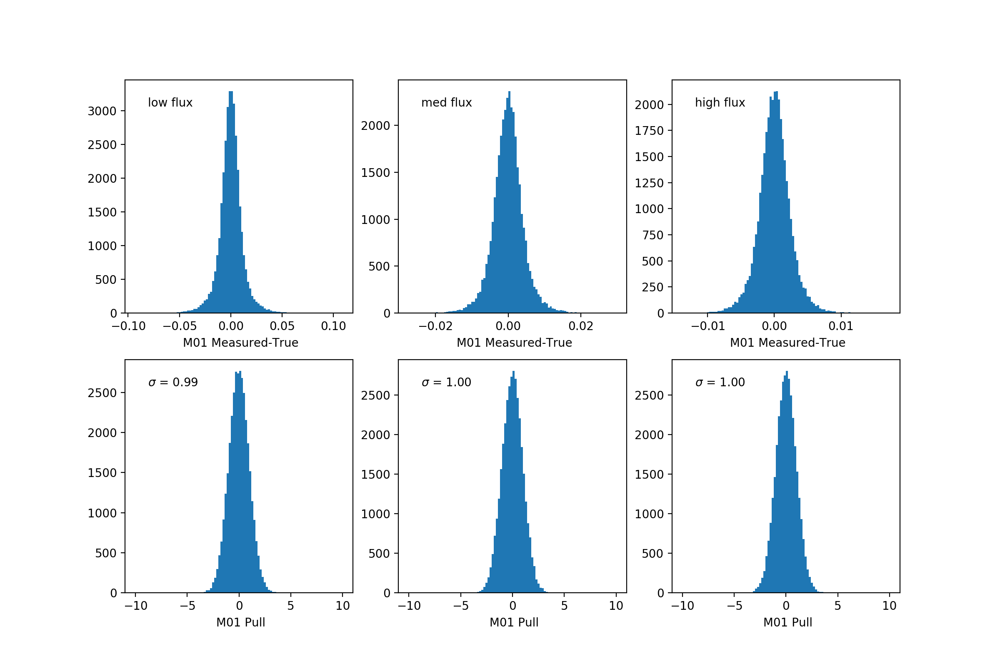

<IPython.core.display.Javascript object>


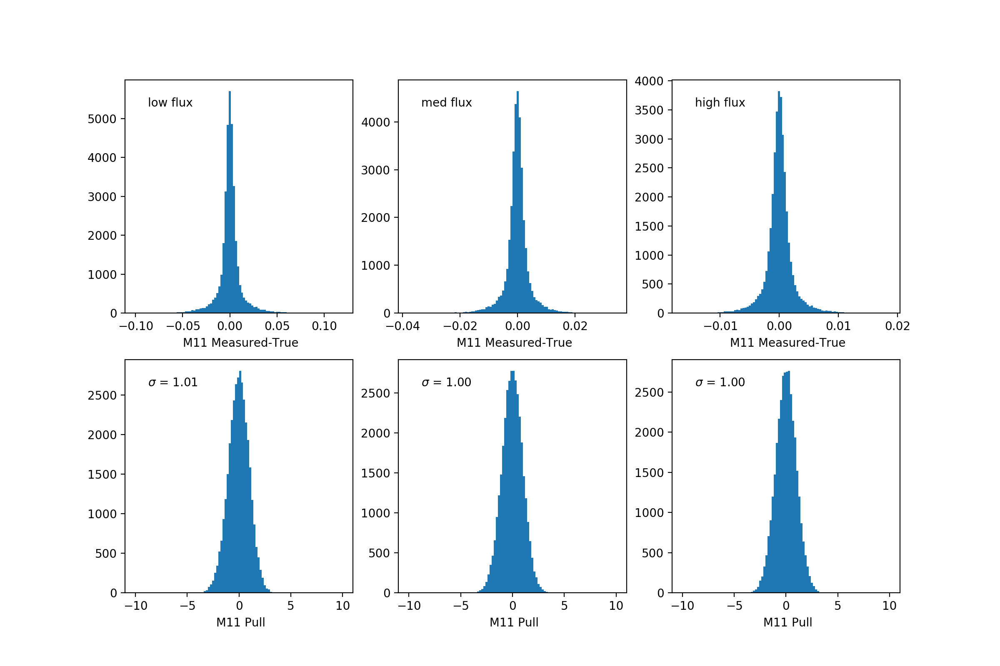

<IPython.core.display.Javascript object>


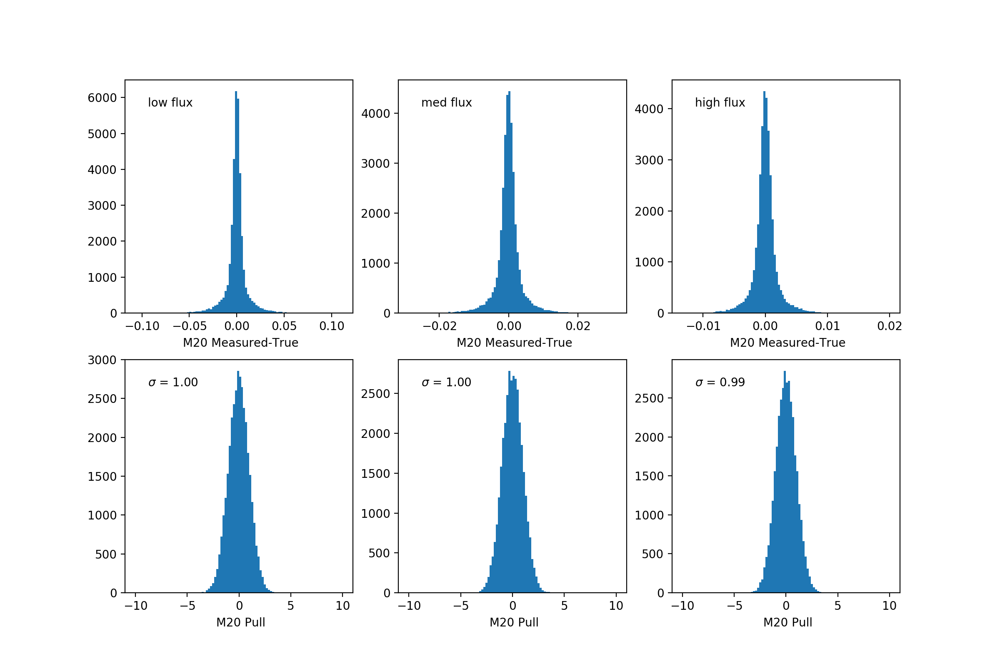

<IPython.core.display.Javascript object>


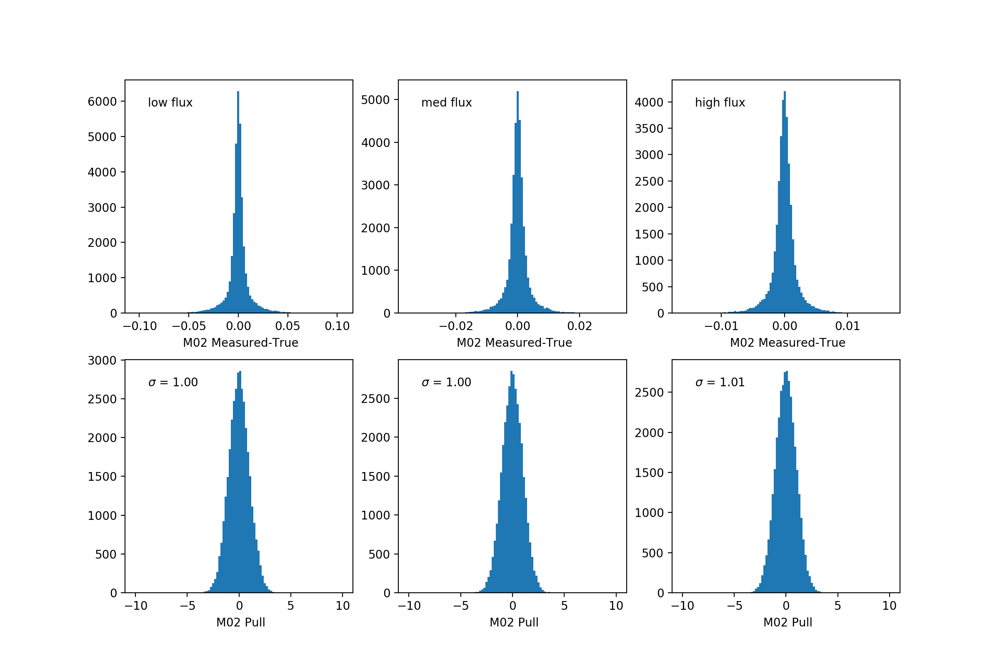

<IPython.core.display.Javascript object>


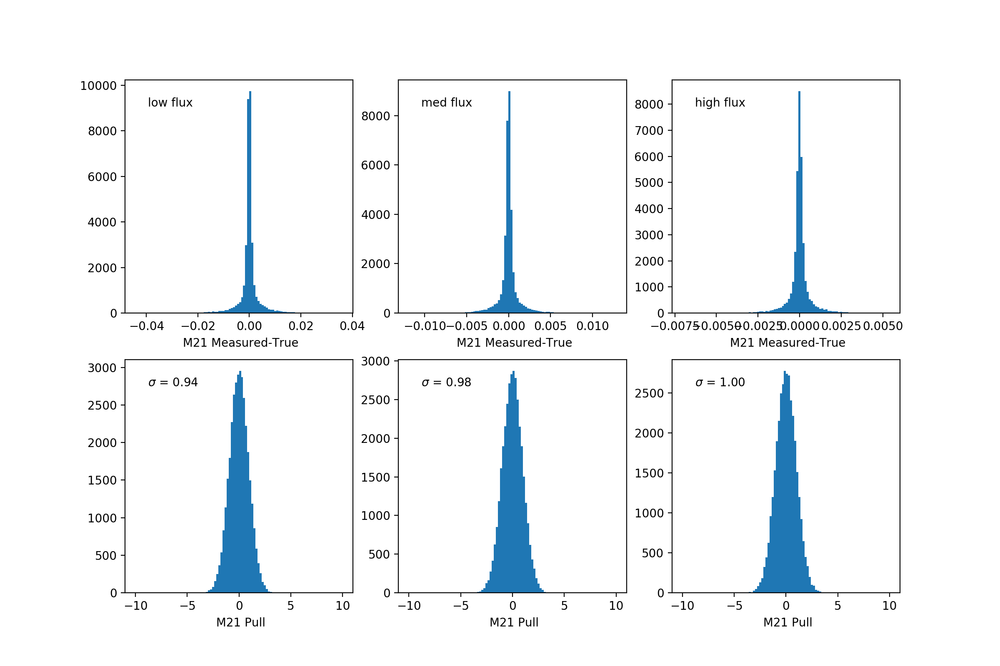

<IPython.core.display.Javascript object>


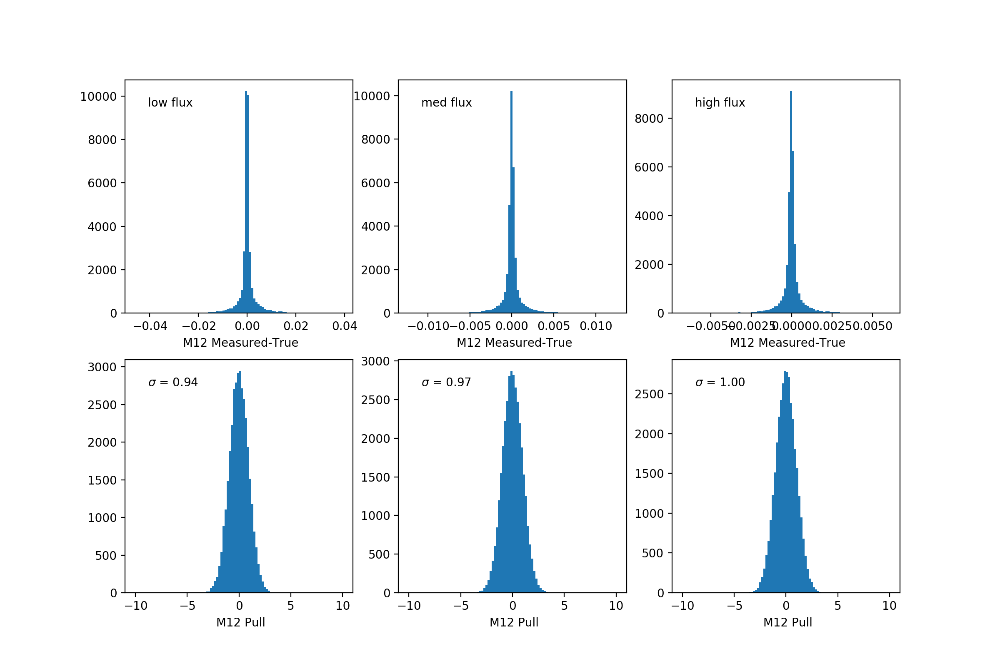

<IPython.core.display.Javascript object>


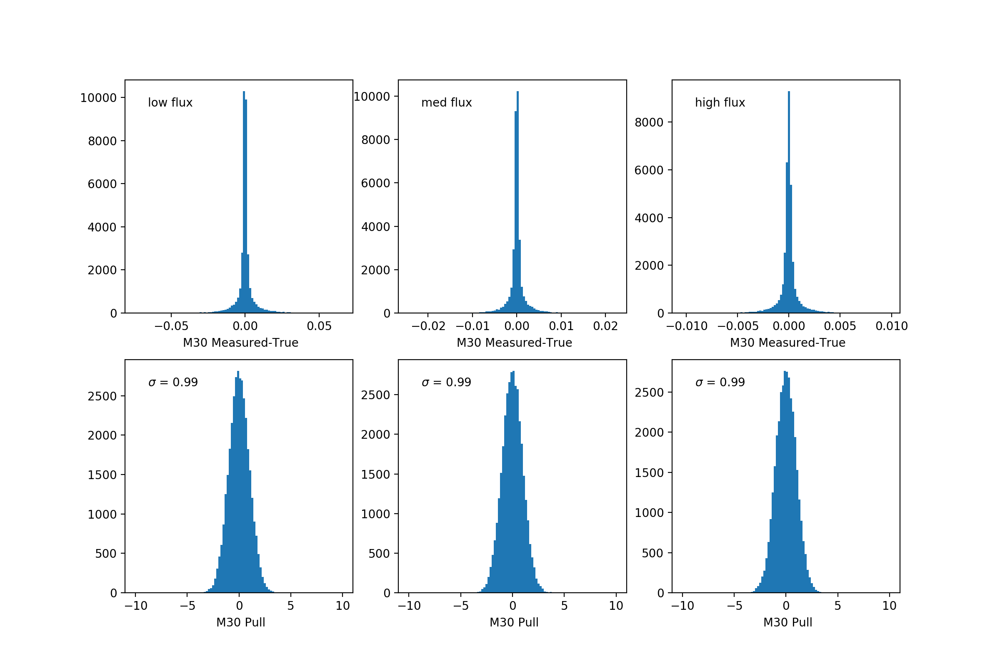

<IPython.core.display.Javascript object>


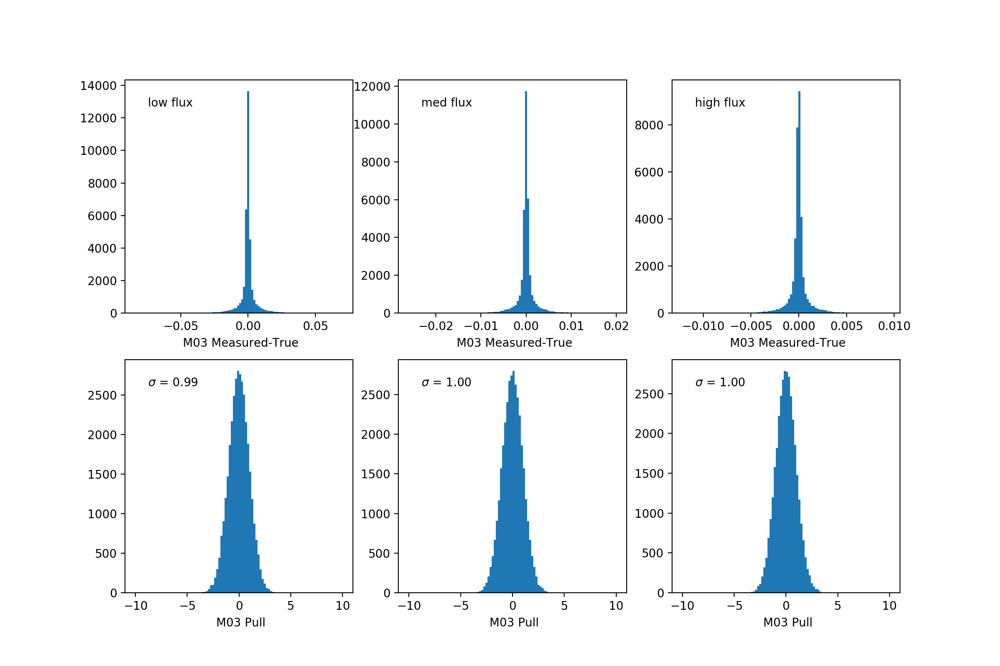

<IPython.core.display.Javascript object>


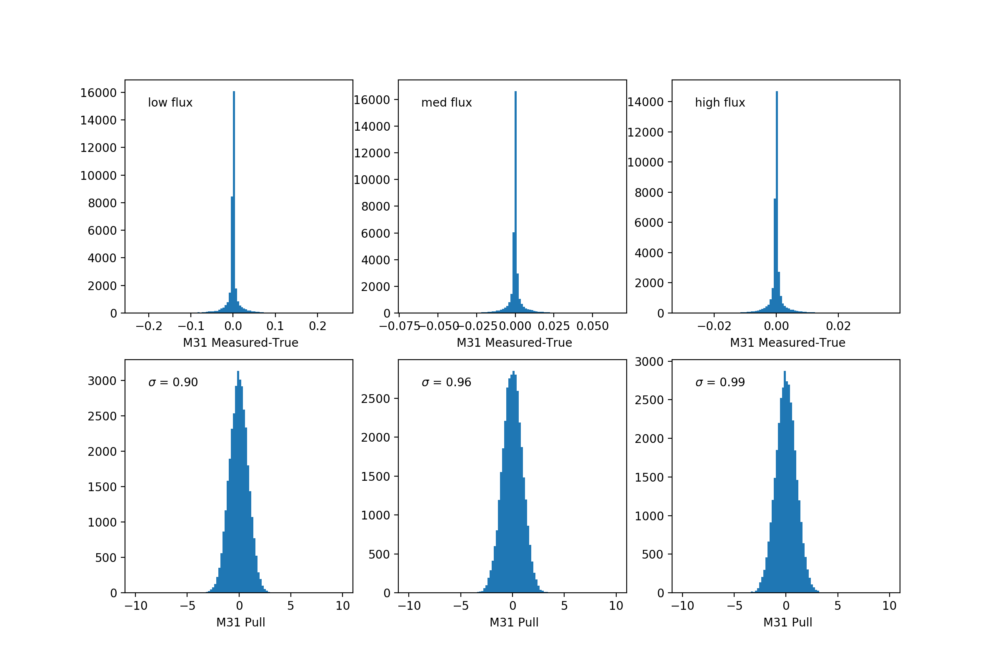

<IPython.core.display.Javascript object>


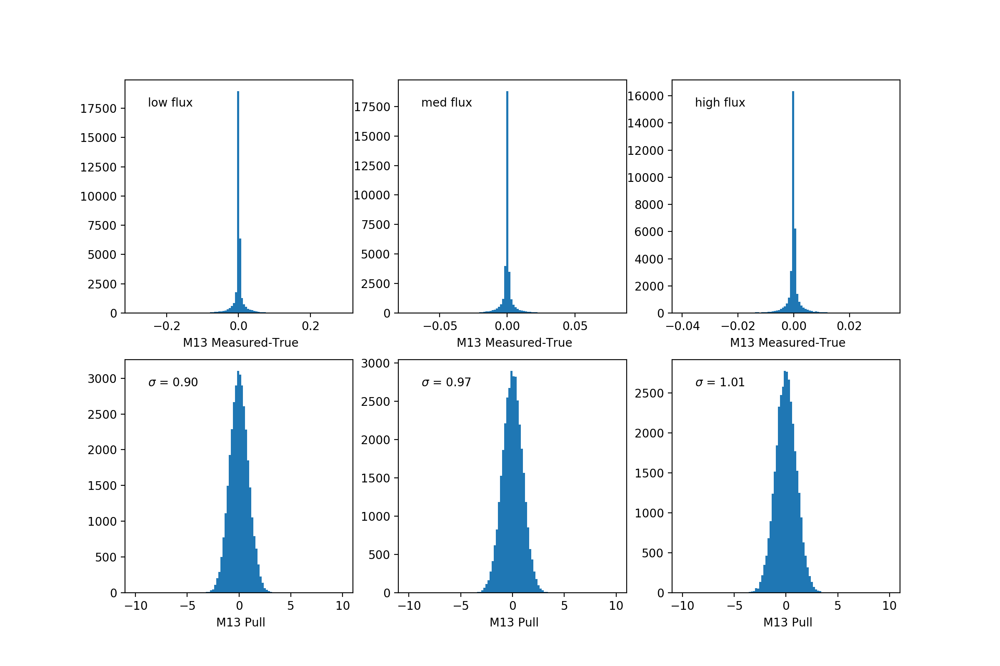

<IPython.core.display.Javascript object>


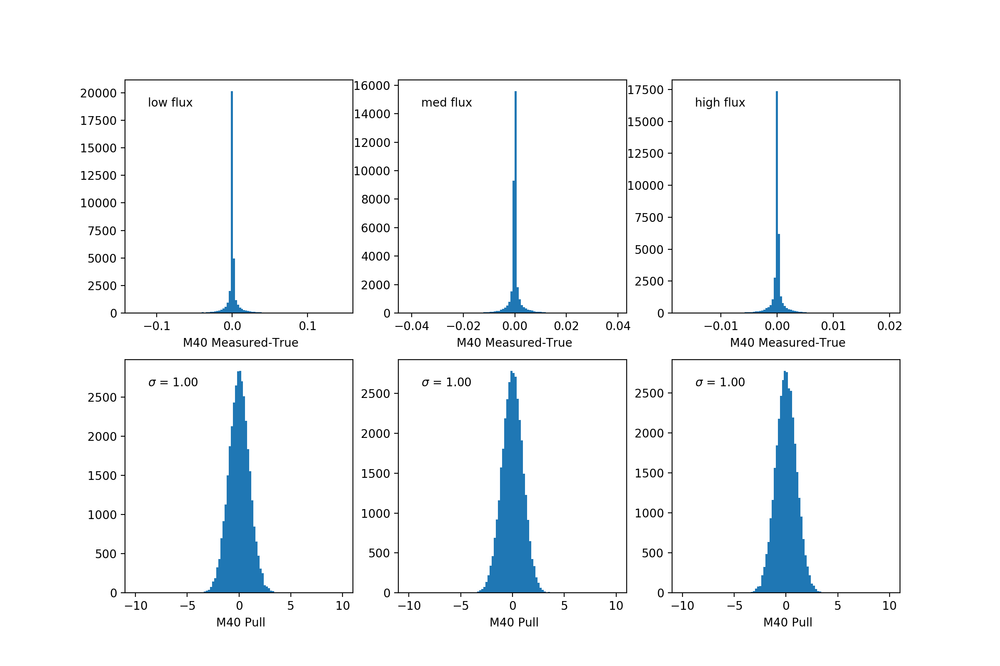

<IPython.core.display.Javascript object>


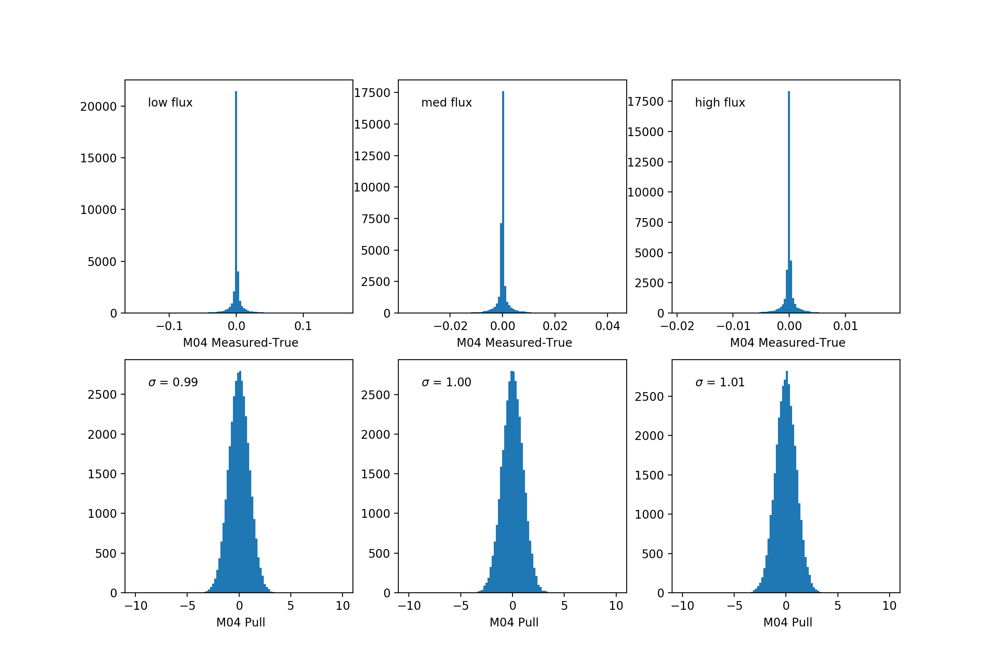

<IPython.core.display.Javascript object>


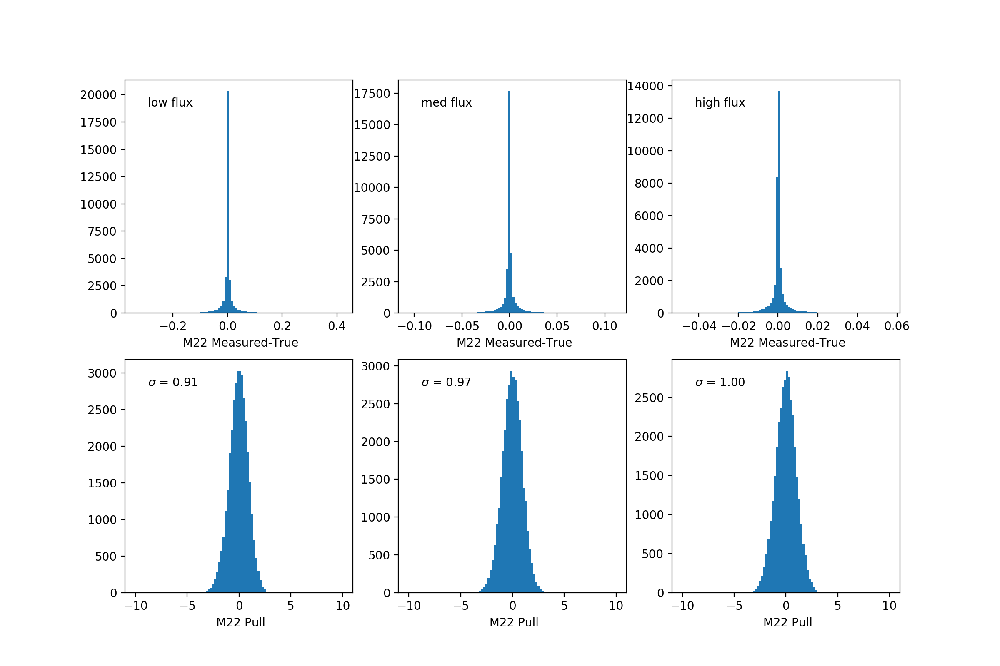

<IPython.core.display.Javascript object>


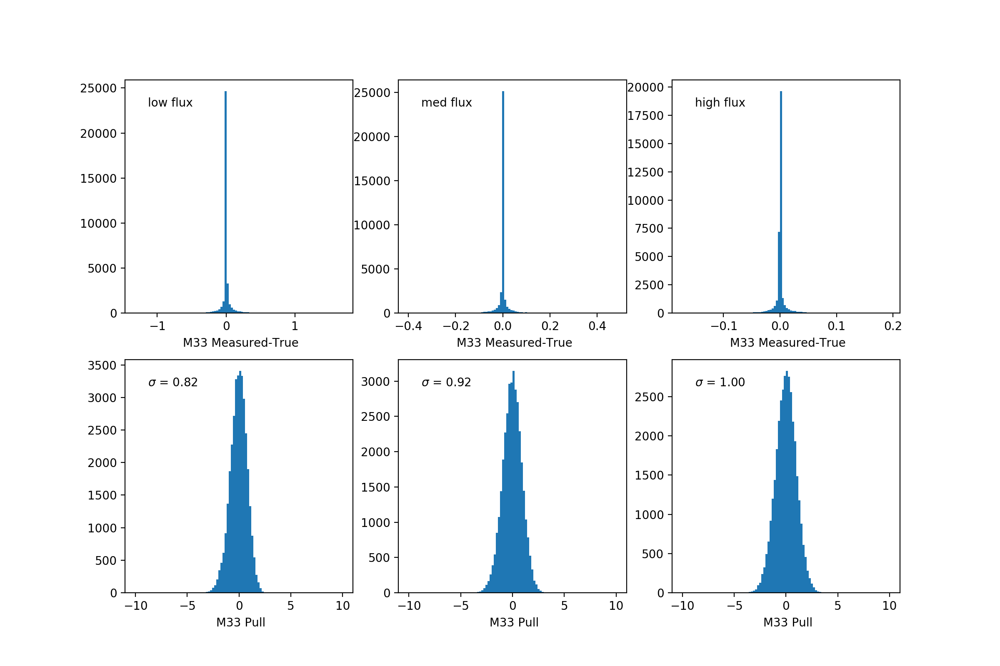

<IPython.core.display.Javascript object>


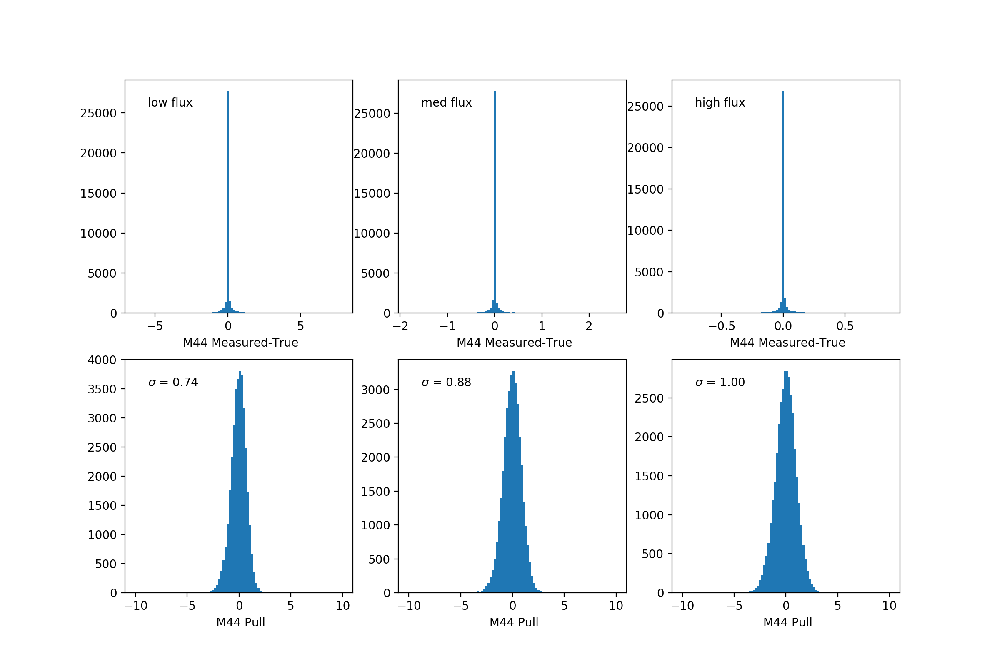

<IPython.core.display.Javascript object>


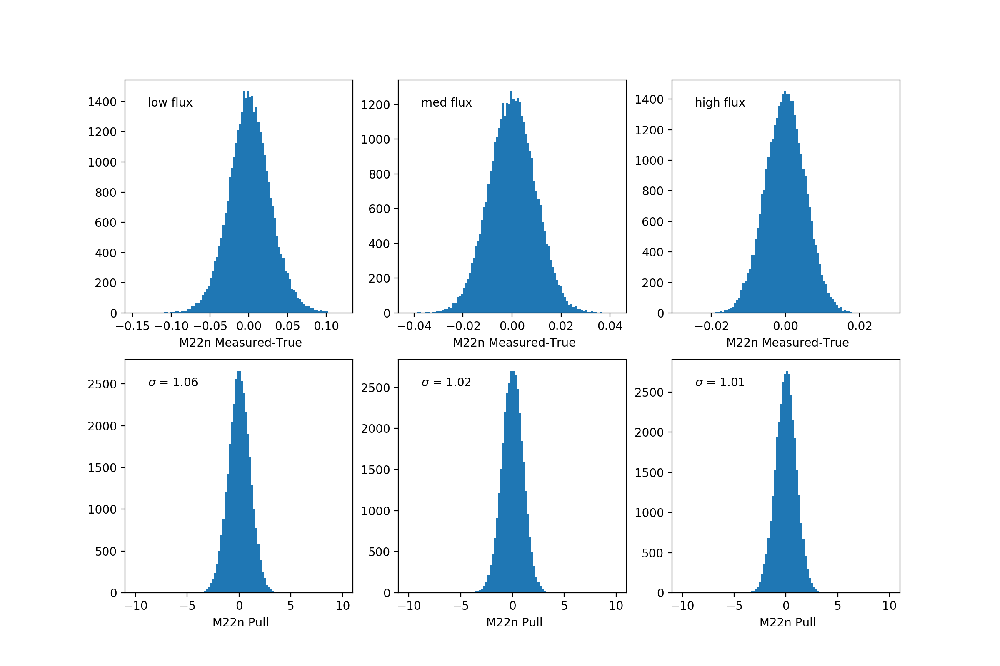

<IPython.core.display.Javascript object>


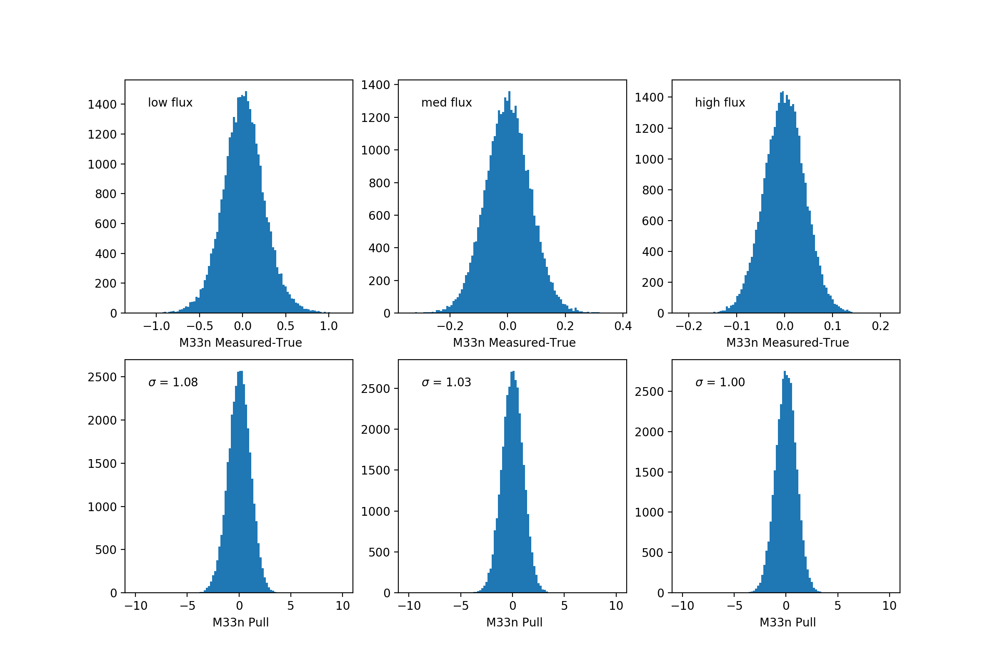

<IPython.core.display.Javascript object>


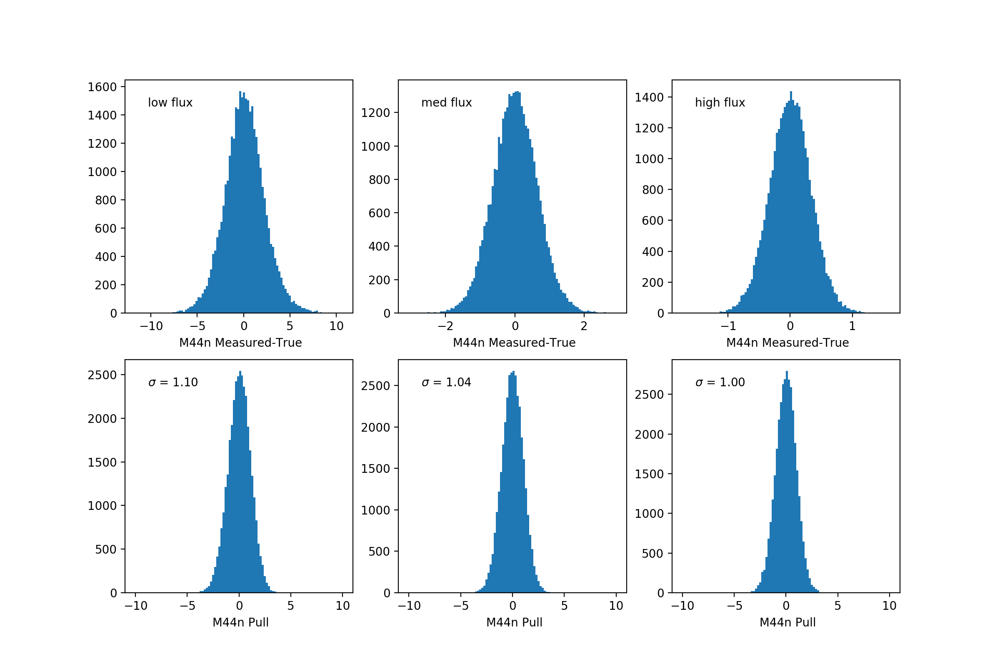

[1.0078442424723406, 0.9954650368071457, 1.0020362614311698, 0.993419662938996, 1.006034178481528, 1.0005428606252738, 0.9995504771332023, 0.994533668566965, 0.9987753636745542, 0.9916864656159103, 1.011158071817334, 1.0044468648540812, 1.008804031319206, 1.00034561971314, 0.9982899017429552, 0.999323164306384, 1.0053466456096327, 1.004584496946096, 1.001735411170285]


In [64]:
pdf = PdfPages("moments.pdf")

momentlist = ['M10','M01','M11','M20','M02','M21','M12','M30','M03','M31','M13','M40','M04','M22','M33','M44','M22n','M33n','M44n']
rmslist = []

for i,amoment in enumerate(momentlist):
    rmslist.append(makepullplots(amoment,perfect=False,pdf=pdf))

pdf.close()
print(rmslist)

In [65]:
# calculate new fudge factors 
oldoldfudge = [1.93,1.93,2.38,2.16,2.16,0.66,0.66,1.06,1.06,2.36,2.36,1.18,1.18,2.69,2.70,2.51,0.93,0.92,0.92]  
oldfudge = [2.00,2.00,2.26,2.13,2.13,0.66,0.66,1.00,1.00,2.38,2.38,1.05,1.05,2.62,2.76,2.72,0.91,0.88,0.86]

newfudge = np.array(oldfudge) * np.array(rmslist)

for am in momentlist:
    print(am,"  ",end="")
print("")
for i in range(len(newfudge)):
    txt = "%4.2f  " % (newfudge[i])
    print(txt,end="")

# NOTE: take averages of symmetric terms... ie. equalize fudge for M20 and M02 

M10   M01   M11   M20   M02   M21   M12   M30   M03   M31   M13   M40   M04   M22   M33   M44   M22n   M33n   M44n   
2.02  1.99  2.26  2.12  2.14  0.66  0.66  0.99  1.00  2.36  2.41  1.05  1.06  2.62  2.76  2.72  0.91  0.88  0.86  

In [66]:
def makepullvsother(vname,vother,pdf=None):
    
    f,ax = plt.subplots(1,3,figsize=(12,5))

    fstr = ['low','med','high']
    
    name_noise = "%s_noise" % (vname)
    name_sigma = "var%s_noise" % (vname)
    name_nonoise = "%s_nonoise" % (vname)
    
    for i in range(3):
        use = ( (df.Sum == pixel_sum[i]) & (df.M00_noise>0.) )
        dft = df[use]
    
        diff = dft[name_noise] - dft[name_nonoise]
        pull = diff/np.sqrt(dft[name_sigma])
    
        other = dft['%s' % (vother)]
        h = ax[i].scatter(other,pull,marker='.',s=0.1)
    
        ax[i].set_xlabel(vother)
        ax[i].set_ylabel(' %s Pull' % (vname))
        
    if pdf:
        pdf.savefig(f)


/nfs/slac/g/ki/ki06/roodman/Software/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


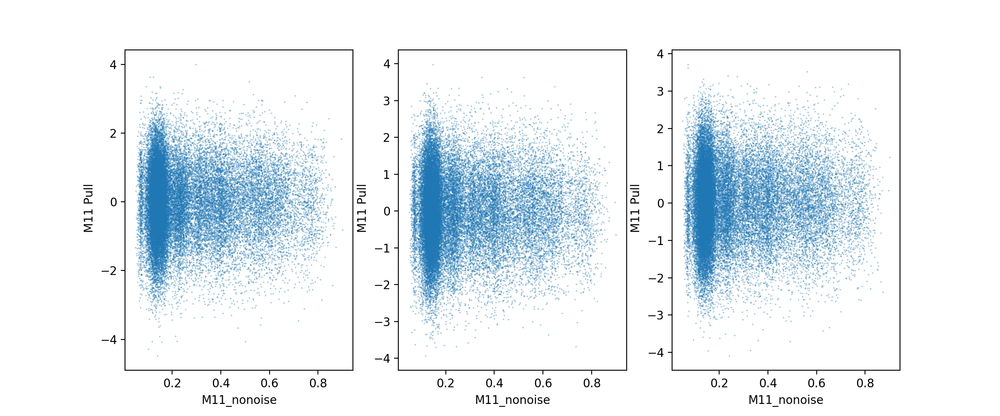

<IPython.core.display.Javascript object>


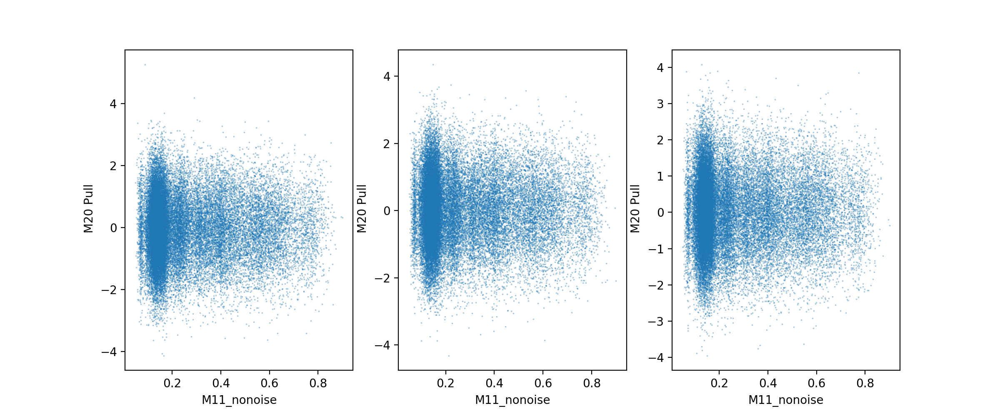

<IPython.core.display.Javascript object>


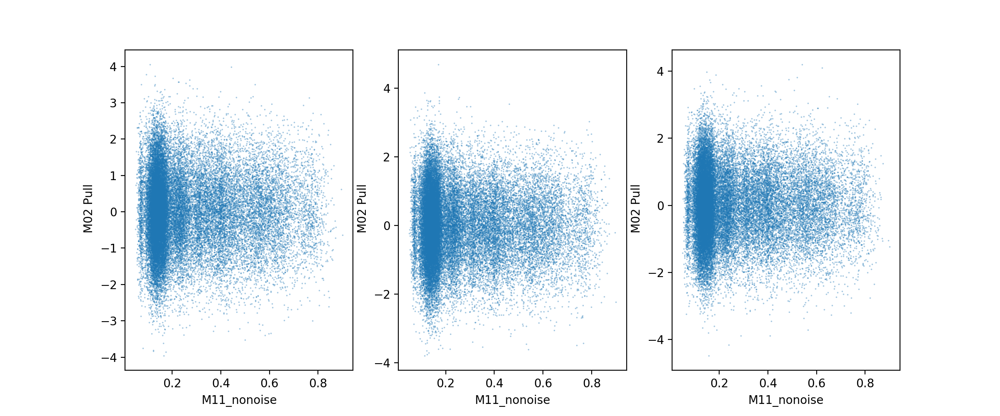

<IPython.core.display.Javascript object>


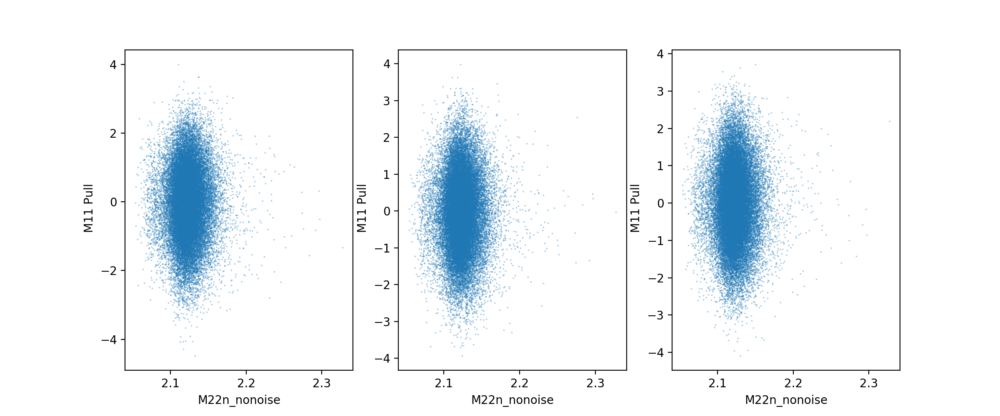

<IPython.core.display.Javascript object>


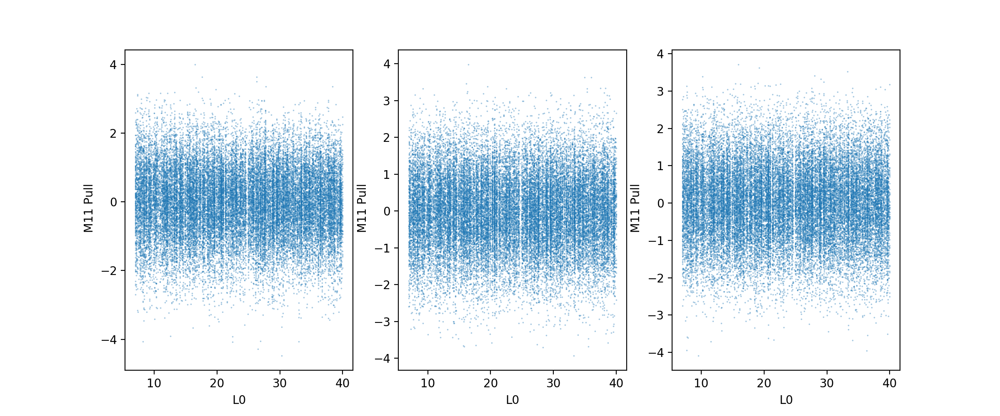

<IPython.core.display.Javascript object>


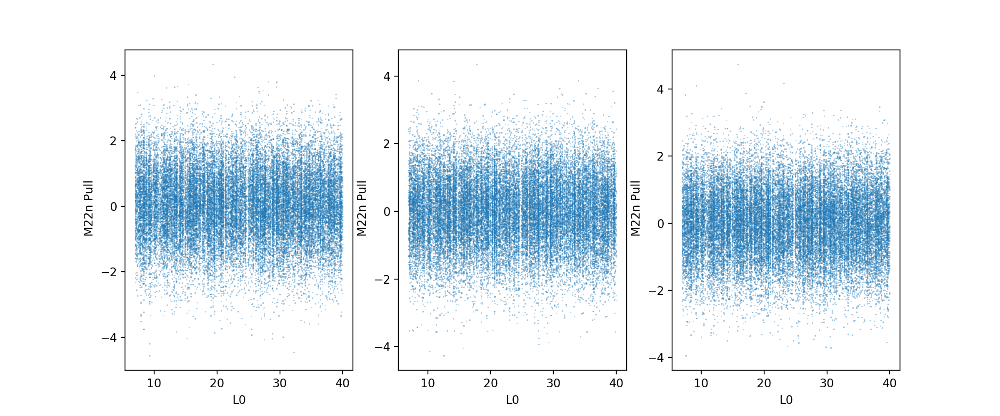

<IPython.core.display.Javascript object>


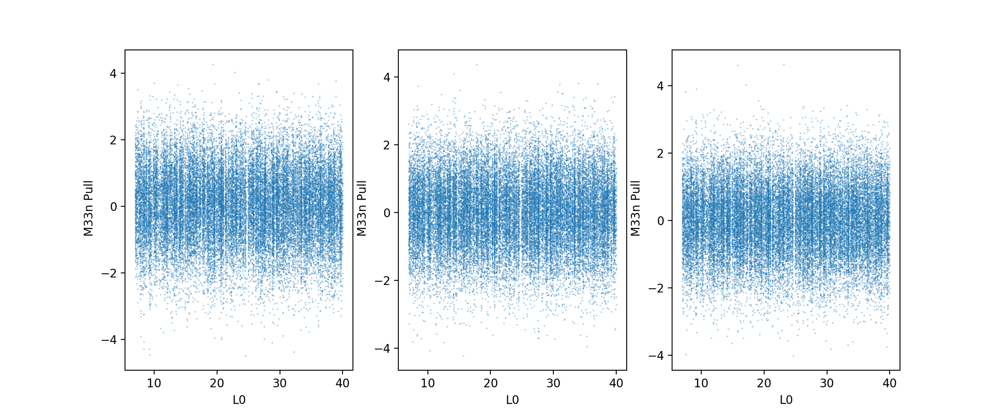

<IPython.core.display.Javascript object>


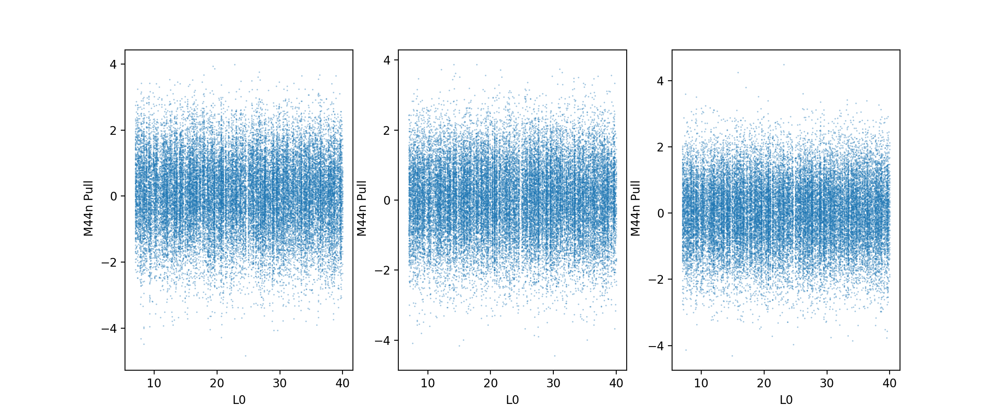

In [68]:
pdf = PdfPages("moments-vsothers.pdf")
makepullvsother("M11",'M11_nonoise')
makepullvsother("M20",'M11_nonoise')
makepullvsother("M02",'M11_nonoise')
makepullvsother("M11",'M22n_nonoise')
makepullvsother("M11",'L0')
makepullvsother("M22n",'L0')
makepullvsother("M33n",'L0')
makepullvsother("M44n",'L0')
pdf.close()

3rd and radial moments

/nfs/slac/g/ki/ki06/roodman/Software/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


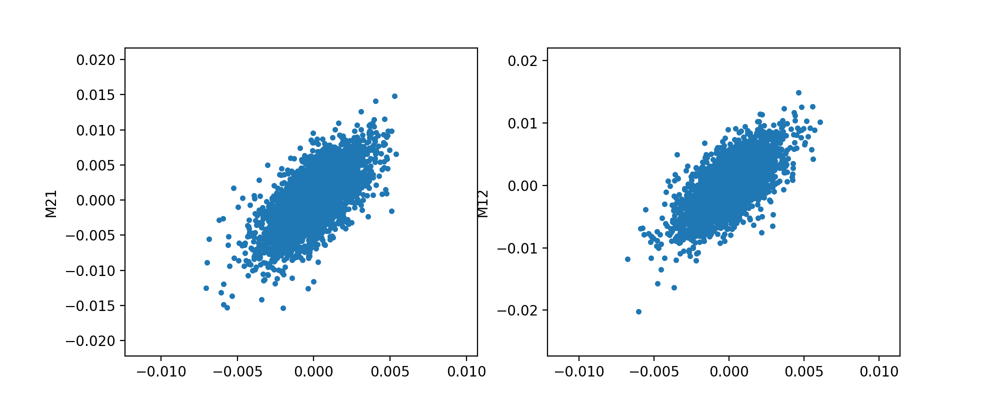

Text(0, 0.5, 'M12')

In [69]:
f,ax = plt.subplots(1,2,figsize=(10,4))

use = (df.Sum == pixel_sum[2])
dft = df[use]
  
h = ax[0].scatter(dft.M21_noise-dft.M21_nonoise,dft.M21_pkernel-dft.M21_nonoise,marker='.')
ax[0].set_ylabel('M21')

h = ax[1].scatter(dft.M12_noise-dft.M12_nonoise,dft.M12_pkernel-dft.M12_nonoise,marker='.')
ax[1].set_ylabel('M12')



radial moments

/nfs/slac/g/ki/ki06/roodman/Software/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


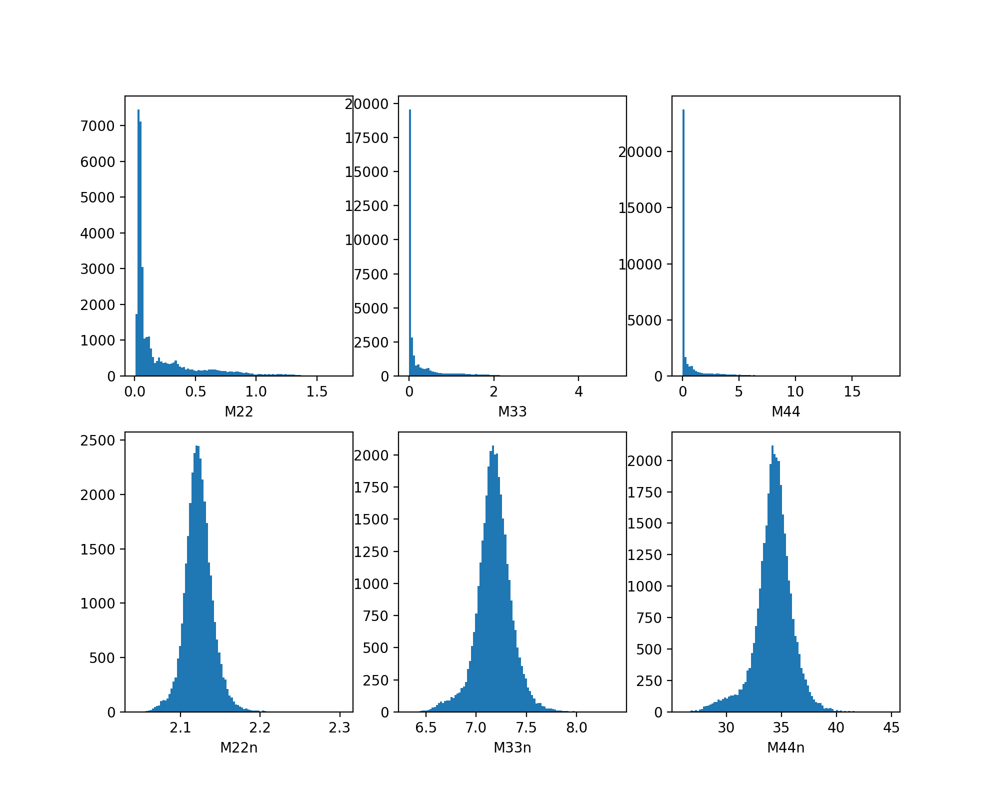

Text(0.5, 0, 'M44n')

In [70]:
f,ax = plt.subplots(2,3,figsize=(10,8))

use = (df.Sum == pixel_sum[2])
dft = df[use]
  
h = ax[0,0].hist(dft.M22_noise,bins=100)
ax[0,0].set_xlabel('M22')

h = ax[0,1].hist(dft.M33_noise,bins=100)
ax[0,1].set_xlabel('M33')

h = ax[0,2].hist(dft.M44_noise,bins=100)
ax[0,2].set_xlabel('M44')

 
h = ax[1,0].hist(dft.M22n_noise,bins=100)
ax[1,0].set_xlabel('M22n')

h = ax[1,1].hist(dft.M33n_noise,bins=100)
ax[1,1].set_xlabel('M33n')

h = ax[1,2].hist(dft.M44n_noise,bins=100)
ax[1,2].set_xlabel('M44n')

# note that in 1D for Gaussians M22/M11^2 = 3 , M33/M11^3 = 15, M44/M11^4 = 105




/nfs/slac/g/ki/ki06/roodman/Software/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


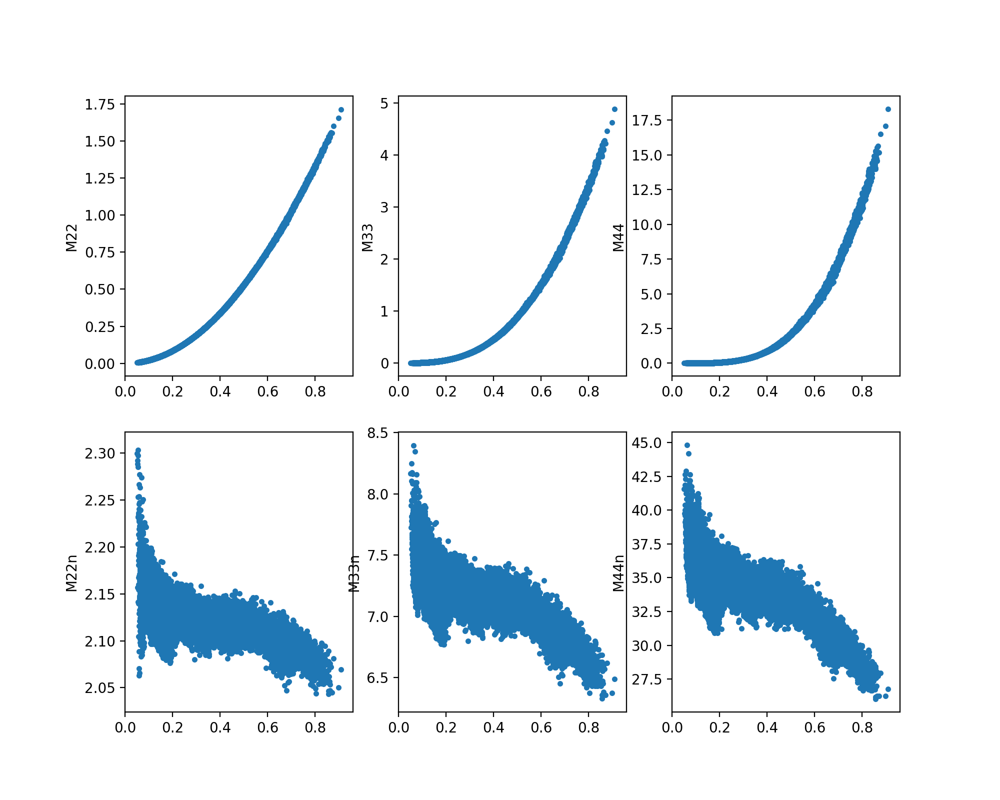

Text(0, 0.5, 'M44n')

In [71]:
f,ax = plt.subplots(2,3,figsize=(10,8))

use = (df.Sum == pixel_sum[2])
dft = df[use]
  
h = ax[0,0].scatter(dft.M11_noise,dft.M22_noise,marker='.')
ax[0,0].set_ylabel('M22')

h = ax[0,1].scatter(dft.M11_noise,dft.M33_noise,marker='.')
ax[0,1].set_ylabel('M33')

h = ax[0,2].scatter(dft.M11_noise,dft.M44_noise,marker='.')
ax[0,2].set_ylabel('M44')

 
h = ax[1,0].scatter(dft.M11_noise,dft.M22n_noise,marker='.')
ax[1,0].set_ylabel('M22n')

h = ax[1,1].scatter(dft.M11_noise,dft.M33n_noise,marker='.')
ax[1,1].set_ylabel('M33n')

h = ax[1,2].scatter(dft.M11_noise,dft.M44n_noise,marker='.')
ax[1,2].set_ylabel('M44n')



/nfs/slac/g/ki/ki06/roodman/Software/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


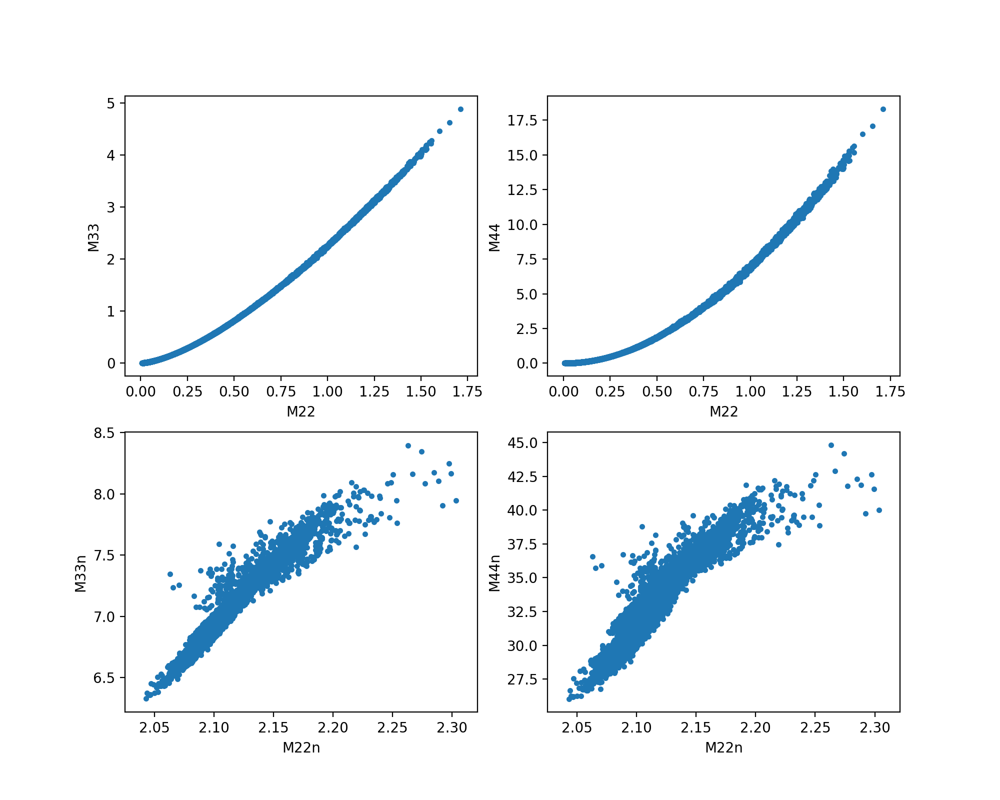

Text(0.5, 0, 'M22n')

In [73]:
f,ax = plt.subplots(2,2,figsize=(10,8))

use = (df.Sum == pixel_sum[2])
dft = df[use]
  
h = ax[0,0].scatter(dft.M22_noise,dft.M33_noise,marker='.')
ax[0,0].set_ylabel('M33')
ax[0,0].set_xlabel('M22')

h = ax[0,1].scatter(dft.M22_noise,dft.M44_noise,marker='.')
ax[0,1].set_ylabel('M44')
ax[0,1].set_xlabel('M22')

h = ax[1,0].scatter(dft.M22n_noise,dft.M33n_noise,marker='.')
ax[1,0].set_ylabel('M33n')
ax[1,0].set_xlabel('M22n')

h = ax[1,1].scatter(dft.M22n_noise,dft.M44n_noise,marker='.')
ax[1,1].set_ylabel('M44n')
ax[1,1].set_xlabel('M22n')


/nfs/slac/g/ki/ki06/roodman/Software/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


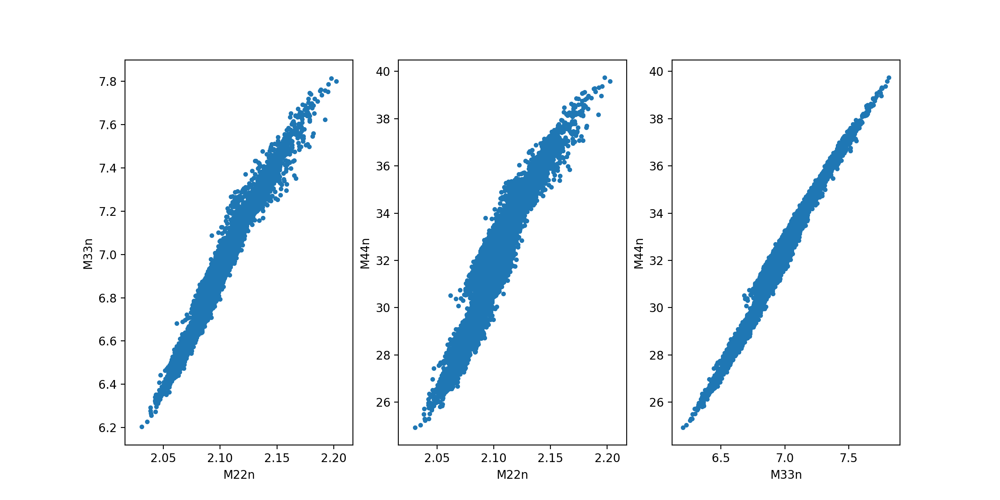

Text(0.5, 0, 'M33n')

In [25]:
f,ax = plt.subplots(1,3,figsize=(12,6))

use = (df.Sum == pixel_sum[2])
dft = df[use]

h = ax[0].scatter(dft.M22n_noise,dft.M33n_noise,marker='.')
ax[0].set_ylabel('M33n')
ax[0].set_xlabel('M22n')

h = ax[1].scatter(dft.M22n_noise,dft.M44n_noise,marker='.')
ax[1].set_ylabel('M44n')
ax[1].set_xlabel('M22n')

h = ax[2].scatter(dft.M33n_noise,dft.M44n_noise,marker='.')
ax[2].set_ylabel('M44n')
ax[2].set_xlabel('M33n')